### Beard to Non-Beard Facial Image Transformation


Please follow installation instructions (installation.md) before running this notebook. Remember that minimum disk space required for this project is about 70GB and minimum GPU memory is 12GB.


### Stage 1: Dataset Preparation

For creating beard - non-beard facial image dataset, we used 3 steps:
- Facial Image Generation with beard
- Segmenting beard on face
- Removing the beard

### Stage1.1: Facial Image Generation with Beard

At this stage, we will used Flux.1-dev for generating high quality - rich detailed facial images. 


In [1]:
from dataset.malepromptgen import generate_prompts
generate_prompts(number_of_prompts = 1000)

Prompts saved to dataset/dataset/prompts.txt


Now we can generate images with these prompts by using Flux1.dev (4 bit quantized version.)

In [3]:
from dataset.ImageGen import ImageGenerator
model_id = "./models/FLUX.1-dev/"
nf4_id = "./models/4bit_transformer/"
ImgGenerator = ImageGenerator(model_id=model_id,nf4_id=nf4_id)
ImgGenerator.forward(limit = 1000) # for demo, I am limiting the generation with 10 examples.


Loading pipeline components...: 100%|██████████| 7/7 [00:01<00:00,  6.10it/s]


['A 42-year-old male of Middle Eastern ethnicity with long afro golden hair, medium skin, round face, round brown eyes, rounded eyebrows, small nose, small lips, and with beard. He does not have wrinkles.\n', 'A 27-year-old male of Middle Eastern ethnicity with buzzed buzz cut auburn hair, tan skin, square face, hooded green eyes, angled eyebrows, button-shaped nose, heart-shaped lips, and with beard. He does not have wrinkles.\n', 'A 31-year-old male of Asian ethnicity with short Caesar cut black hair, medium skin, oval face, monolid blue eyes, arched eyebrows, small nose, heart-shaped lips, and with beard. He does not have wrinkles.\n', 'A 40-year-old male of Asian ethnicity with bald, medium skin, square face, monolid blue eyes, angled eyebrows, large nose, small lips, and with beard. He does not have wrinkles.\n', 'A 56-year-old male of Asian ethnicity with short induction cut black hair, brown skin, round face, round amber eyes, arched eyebrows, large nose, small lips, and with be

100%|██████████| 20/20 [00:15<00:00,  1.26it/s]
Token indices sequence length is longer than the specified maximum sequence length for this model (79 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['wrinkles.']
100%|██████████| 20/20 [00:15<00:00,  1.30it/s]
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['.']
100%|██████████| 20/20 [00:15<00:00,  1.31it/s]
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['.']
100%|██████████| 20/20 [00:15<00:00,  1.30it/s]


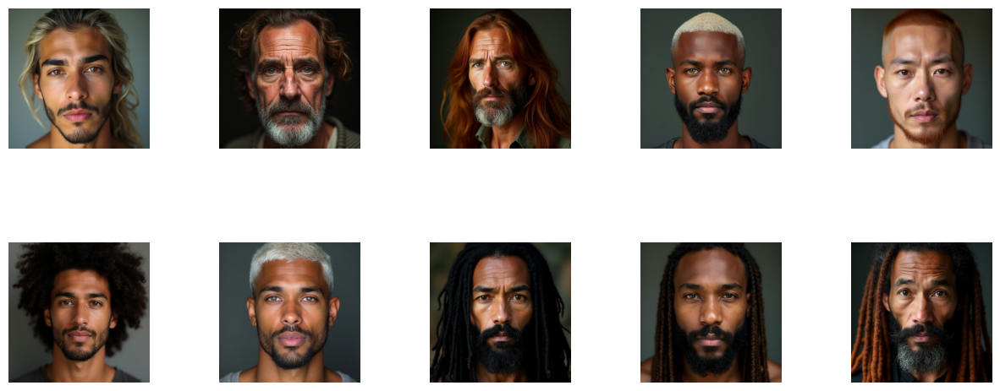

In [4]:
from utils.utils import show_image_gird
show_image_gird("dataset/dataset/BeardFaces")

### Stage 1.2: Segmenting Beard on Facial Image 

To remove the beards from faces, we need to know their locations at the image, our removing strategy will be requiring binary masks, so segmentation will be our solution.  

In [6]:
from dataset.segmentation import Segment
segmentation_model_path = "models/best_hair_117_epoch_v4.pt" 
SegmentModel = Segment(segmentation_model_path)
SegmentModel.forward(limit = 1000)

0it [00:00, ?it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example618.png: 640x640 2 beards, 1 hair, 14.1ms
Speed: 4.1ms preprocess, 14.1ms inference, 342.5ms postprocess per image at shape (1, 3, 640, 640)


1it [00:01,  1.23s/it]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example386.png: 640x640 1 beard, 1 hair, 14.8ms
Speed: 1.0ms preprocess, 14.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example599.png: 640x640 1 beard, 13.7ms
Speed: 1.1ms preprocess, 13.7ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example364.png: 640x640 1 beard, 1 hair, 14.7ms
Speed: 1.1ms preprocess, 14.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example732.png: 640x640 1 beard, 14.2ms
Speed: 1.1ms preprocess, 14.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


5it [00:01,  4.82it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example558.png: 640x640 1 beard, 1 hair, 14.4ms
Speed: 1.2ms preprocess, 14.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example781.png: 640x640 1 beard, 1 hair, 14.7ms
Speed: 1.0ms preprocess, 14.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example175.png: 640x640 1 hair, 13.8ms
Speed: 1.0ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example616.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example658.png: 640x640 1 beard, 12.6ms
Speed: 1.2ms preprocess,

10it [00:01, 10.37it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example548.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example595.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example347.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.2ms preprocess, 13.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example830.png: 640x640 1 hair, 12.7ms
Speed: 1.0ms preprocess, 12.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


14it [00:01, 14.51it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example403.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 0.9ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example84.png: 640x640 1 beard, 14.2ms
Speed: 1.0ms preprocess, 14.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example765.png: 640x640 1 beard, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example308.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


18it [00:01, 18.18it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example203.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example546.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example870.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.2ms preprocess, 13.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example915.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.3ms preprocess, 13.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


22it [00:01, 22.19it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example102.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example331.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example775.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example82.png: 640x640 1 beard, 1 hair, 14.6ms
Speed: 1.8ms preprocess, 14.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


26it [00:01, 25.45it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example252.png: 640x640 2 beards, 1 hair, 14.7ms
Speed: 1.2ms preprocess, 14.7ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example741.png: 640x640 1 beard, 2 hairs, 14.2ms
Speed: 1.3ms preprocess, 14.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example782.png: 640x640 1 hair, 14.4ms
Speed: 1.1ms preprocess, 14.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example514.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.7ms preprocess, 13.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


30it [00:02, 28.63it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example831.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.4ms preprocess, 13.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example129.png: 640x640 2 beards, 1 hair, 13.6ms
Speed: 1.2ms preprocess, 13.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example976.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example36.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


34it [00:02, 30.32it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example79.png: 640x640 1 beard, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example100.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.1ms preprocess, 14.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example47.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example60.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


38it [00:02, 31.06it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example228.png: 640x640 1 beard, 1 hair, 12.7ms
Speed: 2.0ms preprocess, 12.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example734.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.9ms preprocess, 13.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example788.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.3ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example379.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


42it [00:02, 30.66it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example300.png: 640x640 1 beard, 1 hair, 12.8ms
Speed: 1.2ms preprocess, 12.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example243.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.1ms preprocess, 13.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example285.png: 640x640 1 beard, 2 hairs, 13.6ms
Speed: 1.3ms preprocess, 13.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example675.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.3ms preprocess, 13.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


46it [00:02, 30.59it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example12.png: 640x640 1 beard, 13.4ms
Speed: 1.4ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example496.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example199.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example672.png: 640x640 2 beards, 1 hair, 13.3ms
Speed: 4.9ms preprocess, 13.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


50it [00:02, 31.73it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example427.png: 640x640 1 beard, 13.5ms
Speed: 1.4ms preprocess, 13.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example770.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example94.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.2ms preprocess, 13.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example957.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.3ms preprocess, 13.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


54it [00:02, 32.20it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example235.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.2ms preprocess, 13.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example530.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.5ms preprocess, 13.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example158.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example921.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.3ms preprocess, 13.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


58it [00:02, 33.26it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example563.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example532.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.1ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example253.png: 640x640 1 beard, 13.7ms
Speed: 1.3ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example633.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.3ms preprocess, 13.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


62it [00:02, 33.38it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example261.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.2ms preprocess, 13.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example165.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.1ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example28.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.9ms preprocess, 13.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example11.png: 640x640 1 beard, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


66it [00:03, 34.10it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example236.png: 640x640 1 beard, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example648.png: 640x640 1 beard, 2 hairs, 13.5ms
Speed: 1.4ms preprocess, 13.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example359.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.4ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example456.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


70it [00:03, 32.89it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example680.png: 640x640 2 beards, 1 hair, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example706.png: 640x640 1 beard, 13.3ms
Speed: 1.3ms preprocess, 13.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example879.png: 640x640 1 beard, 2 hairs, 13.6ms
Speed: 1.1ms preprocess, 13.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example647.png: 640x640 1 beard, 13.7ms
Speed: 1.6ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


74it [00:03, 33.89it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example89.png: 640x640 1 beard, 1 hair, 12.7ms
Speed: 1.2ms preprocess, 12.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example605.png: 640x640 1 beard, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example287.png: 640x640 1 beard, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example306.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


78it [00:03, 34.50it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example844.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example231.png: 640x640 1 beard, 13.9ms
Speed: 1.4ms preprocess, 13.9ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example593.png: 640x640 1 beard, 13.3ms
Speed: 1.2ms preprocess, 13.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example581.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


82it [00:03, 34.24it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example324.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example963.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.1ms preprocess, 13.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example822.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.1ms preprocess, 13.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example883.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


86it [00:03, 33.96it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example895.png: 640x640 1 beard, 1 hair, 12.7ms
Speed: 1.3ms preprocess, 12.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example852.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example508.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.2ms preprocess, 13.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example237.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.2ms preprocess, 13.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


90it [00:03, 32.82it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example892.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example603.png: 640x640 3 beards, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example634.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.3ms preprocess, 14.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example967.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.6ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


94it [00:03, 33.59it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example130.png: 640x640 1 beard, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example217.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.4ms preprocess, 13.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example487.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.2ms preprocess, 13.7ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example850.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


98it [00:04, 33.39it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example920.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.2ms preprocess, 13.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example393.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.8ms preprocess, 13.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example889.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.3ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example940.png: 640x640 2 hairs, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


102it [00:04, 35.11it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example789.png: 640x640 1 beard, 2 hairs, 12.7ms
Speed: 1.2ms preprocess, 12.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example983.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.1ms preprocess, 13.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example157.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example683.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


106it [00:04, 34.41it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example466.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example408.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.3ms preprocess, 14.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example783.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example807.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


110it [00:04, 33.94it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example623.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example276.png: 640x640 1 beard, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example513.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.3ms preprocess, 13.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example215.png: 640x640 1 beard, 13.3ms
Speed: 1.2ms preprocess, 13.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


114it [00:04, 34.63it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example594.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.3ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example366.png: 640x640 1 beard, 2 hairs, 13.2ms
Speed: 1.1ms preprocess, 13.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example277.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example50.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example283.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 

119it [00:04, 36.99it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example601.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example769.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.7ms preprocess, 13.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example260.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.2ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example81.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.3ms preprocess, 13.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


123it [00:04, 37.74it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example862.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.3ms preprocess, 14.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example673.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.3ms preprocess, 13.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example529.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.3ms preprocess, 14.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example258.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.4ms preprocess, 13.9ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


127it [00:04, 35.16it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example380.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.1ms preprocess, 14.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example34.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example505.png: 640x640 1 beard, 13.8ms
Speed: 1.5ms preprocess, 13.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example446.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.1ms preprocess, 13.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


131it [00:04, 34.61it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example110.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example402.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.5ms preprocess, 13.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example755.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.4ms preprocess, 13.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example642.png: 640x640 1 beard, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


135it [00:05, 34.15it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example817.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example182.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.2ms preprocess, 13.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example816.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.1ms preprocess, 13.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example768.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.4ms preprocess, 13.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


139it [00:05, 33.70it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example583.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example494.png: 640x640 1 beard, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example991.png: 640x640 1 beard, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example223.png: 640x640 1 beard, 3 hairs, 14.1ms
Speed: 1.6ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


143it [00:05, 33.65it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example108.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.5ms preprocess, 14.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example751.png: 640x640 1 beard, 13.8ms
Speed: 1.8ms preprocess, 13.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example322.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example764.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


147it [00:05, 33.43it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example845.png: 640x640 1 beard, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example877.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example246.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example573.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.7ms preprocess, 13.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


151it [00:05, 32.25it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example211.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example450.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.4ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example923.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.2ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example221.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 2.1ms preprocess, 14.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


155it [00:05, 31.92it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example119.png: 640x640 1 beard, 1 hair, 14.7ms
Speed: 1.8ms preprocess, 14.7ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example267.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.3ms preprocess, 13.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example439.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.6ms preprocess, 13.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example425.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


159it [00:05, 33.60it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example552.png: 640x640 2 beards, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example163.png: 640x640 1 beard, 13.0ms
Speed: 1.6ms preprocess, 13.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example619.png: 640x640 1 beard, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example987.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.4ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


163it [00:05, 33.51it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example480.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 2.1ms preprocess, 13.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example901.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example739.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example626.png: 640x640 2 beards, 1 hair, 13.3ms
Speed: 1.1ms preprocess, 13.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


167it [00:06, 34.41it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example994.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example531.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.1ms preprocess, 13.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example564.png: 640x640 3 beards, 1 hair, 13.7ms
Speed: 1.1ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example282.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.0ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


171it [00:06, 35.34it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example643.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example763.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example42.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.5ms preprocess, 13.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example405.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.1ms preprocess, 13.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


175it [00:06, 34.79it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example597.png: 640x640 1 beard, 2 hairs, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example168.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example786.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.0ms preprocess, 13.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example248.png: 640x640 1 beard, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


179it [00:06, 35.72it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example684.png: 640x640 1 beard, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example271.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example948.png: 640x640 1 beard, 13.7ms
Speed: 1.2ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example544.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example988.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.1ms preprocess

184it [00:06, 36.73it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example10.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example710.png: 640x640 3 beards, 1 hair, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example404.png: 640x640 1 beard, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example525.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.1ms preprocess, 13.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


188it [00:06, 35.41it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example602.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.6ms preprocess, 13.6ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example946.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example549.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 2.7ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example637.png: 640x640 1 beard, 13.7ms
Speed: 1.1ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


192it [00:06, 34.62it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example907.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.0ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example714.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.4ms preprocess, 13.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example54.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example924.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.4ms preprocess, 13.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


196it [00:06, 34.38it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example460.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example604.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example113.png: 640x640 2 beards, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example827.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.2ms preprocess, 13.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


200it [00:06, 34.99it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example712.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.3ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example416.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.1ms preprocess, 13.7ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example351.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example745.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


204it [00:07, 34.53it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example262.png: 640x640 1 beard, 2 hairs, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example536.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.0ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example430.png: 640x640 1 beard, 13.7ms
Speed: 1.0ms preprocess, 13.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example488.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


208it [00:07, 35.37it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example312.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.3ms preprocess, 13.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example797.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example307.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example177.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.1ms preprocess, 13.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


212it [00:07, 35.02it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example362.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.1ms preprocess, 13.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example454.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example982.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example344.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.4ms preprocess, 13.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


216it [00:07, 34.39it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example132.png: 640x640 1 beard, 13.1ms
Speed: 1.4ms preprocess, 13.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example973.png: 640x640 1 beard, 1 hair, 12.7ms
Speed: 1.0ms preprocess, 12.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example630.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example310.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.1ms preprocess, 13.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


220it [00:07, 34.32it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example899.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.2ms preprocess, 13.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example275.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.7ms preprocess, 14.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example0.png: 640x640 1 beard, 2 hairs, 13.8ms
Speed: 3.0ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example660.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.6ms preprocess, 13.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


224it [00:07, 33.05it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example613.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example151.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.2ms preprocess, 13.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example780.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.2ms preprocess, 13.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example990.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.2ms preprocess, 13.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


228it [00:07, 33.16it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example95.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.4ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example106.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.5ms preprocess, 14.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example458.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example390.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


232it [00:07, 33.91it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example855.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.2ms preprocess, 13.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example143.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.4ms preprocess, 13.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example893.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example409.png: 640x640 1 beard, 2 hairs, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


236it [00:08, 33.78it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example863.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.2ms preprocess, 13.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example475.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.2ms preprocess, 13.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example871.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.2ms preprocess, 13.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example906.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.2ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


240it [00:08, 32.72it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example136.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example829.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example319.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example631.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


244it [00:08, 32.85it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example561.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.3ms preprocess, 14.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example654.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example396.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.8ms preprocess, 13.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example120.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.6ms preprocess, 13.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


248it [00:08, 31.93it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example911.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.3ms preprocess, 13.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example809.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.4ms preprocess, 13.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example298.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.4ms preprocess, 13.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example941.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


252it [00:08, 31.25it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example554.png: 640x640 2 beards, 1 hair, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example420.png: 640x640 1 beard, 2 hairs, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example958.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.1ms preprocess, 14.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example478.png: 640x640 2 beards, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


256it [00:08, 31.11it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example640.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.5ms preprocess, 13.5ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example826.png: 640x640 2 beards, 13.8ms
Speed: 1.6ms preprocess, 13.8ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example659.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example355.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


260it [00:08, 29.97it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example716.png: 640x640 1 beard, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example358.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example542.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example833.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


264it [00:08, 30.11it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example107.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example729.png: 640x640 1 beard, 13.3ms
Speed: 1.3ms preprocess, 13.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example138.png: 640x640 1 beard, 2 hairs, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example767.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.4ms preprocess, 14.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


268it [00:09, 31.72it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example644.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example580.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example153.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example562.png: 640x640 1 beard, 14.1ms
Speed: 1.4ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


272it [00:09, 33.81it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example933.png: 640x640 1 beard, 14.0ms
Speed: 1.9ms preprocess, 14.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example414.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.4ms preprocess, 14.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example7.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example173.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


276it [00:09, 33.40it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example188.png: 640x640 1 beard, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example569.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.3ms preprocess, 13.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example361.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example726.png: 640x640 1 beard, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


280it [00:09, 34.25it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example512.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example255.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example207.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example314.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.4ms preprocess, 14.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


284it [00:09, 33.84it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example596.png: 640x640 2 beards, 1 hair, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example909.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.3ms preprocess, 13.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example615.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example540.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.7ms preprocess, 13.7ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


288it [00:09, 34.28it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example9.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example800.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.3ms preprocess, 13.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example172.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example394.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


292it [00:09, 34.61it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example694.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.3ms preprocess, 13.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example465.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.9ms preprocess, 14.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example399.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example137.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


296it [00:09, 33.53it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example527.png: 640x640 2 beards, 1 hair, 13.7ms
Speed: 1.8ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example821.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.3ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example641.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.8ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example579.png: 640x640 1 beard, 1 hair, 14.4ms
Speed: 1.4ms preprocess, 14.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


300it [00:10, 33.87it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example313.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.2ms preprocess, 14.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example469.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example284.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.3ms preprocess, 13.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example118.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


304it [00:10, 33.42it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example190.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.3ms preprocess, 13.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example57.png: 640x640 1 beard, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example992.png: 640x640 1 beard, 14.2ms
Speed: 1.5ms preprocess, 14.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example368.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.3ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


308it [00:10, 33.44it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example611.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.3ms preprocess, 14.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example471.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.3ms preprocess, 14.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example453.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.5ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example242.png: 640x640 1 beard, 14.4ms
Speed: 1.3ms preprocess, 14.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


312it [00:10, 33.07it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example702.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.2ms preprocess, 14.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example919.png: 640x640 1 beard, 2 hairs, 13.6ms
Speed: 1.4ms preprocess, 13.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example567.png: 640x640 1 beard, 14.3ms
Speed: 1.3ms preprocess, 14.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example16.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.3ms preprocess, 13.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


316it [00:10, 33.97it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example103.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.6ms preprocess, 14.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example417.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example974.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example646.png: 640x640 1 beard, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


320it [00:10, 33.79it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example176.png: 640x640 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example686.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.5ms preprocess, 13.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example857.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.6ms preprocess, 13.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example846.png: 640x640 1 beard, 13.9ms
Speed: 1.5ms preprocess, 13.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


324it [00:10, 33.54it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example960.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.6ms preprocess, 13.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example477.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example397.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.6ms preprocess, 14.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example270.png: 640x640 1 beard, 2 hairs, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


328it [00:10, 32.98it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example771.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.4ms preprocess, 13.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example370.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.4ms preprocess, 13.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example932.png: 640x640 1 beard, 1 hair, 14.8ms
Speed: 2.4ms preprocess, 14.8ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example156.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.2ms preprocess, 14.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


332it [00:10, 33.08it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example447.png: 640x640 1 beard, 14.3ms
Speed: 1.3ms preprocess, 14.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example371.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.6ms preprocess, 13.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example80.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example652.png: 640x640 1 beard, 14.4ms
Speed: 1.6ms preprocess, 14.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


336it [00:11, 32.76it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example197.png: 640x640 1 beard, 1 hair, 15.0ms
Speed: 1.5ms preprocess, 15.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example656.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.1ms preprocess, 13.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example406.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example111.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.3ms preprocess, 13.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


340it [00:11, 31.84it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example73.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example320.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example381.png: 640x640 1 beard, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example43.png: 640x640 1 beard, 2 hairs, 13.0ms
Speed: 1.5ms preprocess, 13.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


344it [00:11, 32.23it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example847.png: 640x640 1 beard, 2 hairs, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example291.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.6ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example951.png: 640x640 2 beards, 2 hairs, 13.8ms
Speed: 1.0ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example795.png: 640x640 1 beard, 1 hair, 12.8ms
Speed: 1.6ms preprocess, 12.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


348it [00:11, 33.47it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example485.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.1ms preprocess, 13.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example577.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.3ms preprocess, 13.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example796.png: 640x640 1 beard, 13.8ms
Speed: 1.3ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example421.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.1ms preprocess, 13.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


352it [00:11, 34.35it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example977.png: 640x640 (no detections), 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example687.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example3.png: 640x640 1 beard, 13.7ms
Speed: 1.2ms preprocess, 13.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example708.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.3ms preprocess, 13.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


356it [00:11, 34.44it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example718.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example342.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example166.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.0ms preprocess, 13.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example472.png: 640x640 1 beard, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


360it [00:11, 35.41it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example555.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 0.9ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example104.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example876.png: 640x640 2 beards, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example388.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


364it [00:11, 34.09it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example257.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.4ms preprocess, 13.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example922.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example547.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.1ms preprocess, 13.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example790.png: 640x640 1 beard, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


368it [00:12, 34.18it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example949.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example412.png: 640x640 1 beard, 3 hairs, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example463.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.6ms preprocess, 13.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example67.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


372it [00:12, 34.12it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example369.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.2ms preprocess, 13.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example309.png: 640x640 1 beard, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example97.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example442.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


376it [00:12, 34.27it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example667.png: 640x640 1 beard, 13.9ms
Speed: 1.3ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example219.png: 640x640 1 beard, 13.2ms
Speed: 1.0ms preprocess, 13.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example226.png: 640x640 1 beard, 2 hairs, 12.8ms
Speed: 1.2ms preprocess, 12.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example146.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.1ms preprocess, 13.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


380it [00:12, 34.53it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example52.png: 640x640 1 hair, 13.6ms
Speed: 1.5ms preprocess, 13.6ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example903.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example413.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example433.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


384it [00:12, 33.61it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example479.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example55.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.0ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example979.png: 640x640 1 beard, 1 hair, 12.9ms
Speed: 1.1ms preprocess, 12.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example316.png: 640x640 1 beard, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


388it [00:12, 33.92it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example372.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example238.png: 640x640 1 beard, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example622.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.4ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example679.png: 640x640 2 beards, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


392it [00:12, 35.17it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example193.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.1ms preprocess, 13.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example139.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.0ms preprocess, 13.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example149.png: 640x640 1 beard, 2 hairs, 12.9ms
Speed: 1.1ms preprocess, 12.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example159.png: 640x640 1 beard, 13.7ms
Speed: 1.0ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


396it [00:12, 35.94it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example614.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example170.png: 640x640 1 beard, 2 hairs, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example272.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.1ms preprocess, 13.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example29.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.1ms preprocess, 13.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


400it [00:12, 34.51it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example518.png: 640x640 1 beard, 2 hairs, 13.7ms
Speed: 1.0ms preprocess, 13.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example147.png: 640x640 1 beard, 14.0ms
Speed: 1.4ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example937.png: 640x640 1 beard, 2 hairs, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example738.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


404it [00:13, 34.27it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example503.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example793.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example210.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.1ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example105.png: 640x640 3 beards, 1 hair, 12.7ms
Speed: 1.5ms preprocess, 12.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


408it [00:13, 35.35it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example784.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example749.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.1ms preprocess, 13.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example731.png: 640x640 1 beard, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example953.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.1ms preprocess, 13.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


412it [00:13, 35.36it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example955.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example803.png: 640x640 1 beard, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example891.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example804.png: 640x640 3 beards, 1 hair, 13.5ms
Speed: 1.0ms preprocess, 13.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


416it [00:13, 36.08it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example86.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.2ms preprocess, 13.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example198.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example87.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.5ms preprocess, 13.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example999.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.7ms preprocess, 14.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


420it [00:13, 33.83it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example935.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example41.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.0ms preprocess, 14.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example72.png: 640x640 1 beard, 13.7ms
Speed: 1.0ms preprocess, 13.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example75.png: 640x640 2 beards, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


424it [00:13, 34.79it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example787.png: 640x640 1 beard, 1 hair, 12.7ms
Speed: 1.3ms preprocess, 12.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example700.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example538.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.1ms preprocess, 13.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example635.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.0ms preprocess, 13.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


428it [00:13, 35.82it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example218.png: 640x640 1 beard, 2 hairs, 13.4ms
Speed: 1.3ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example792.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.3ms preprocess, 13.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example571.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.9ms preprocess, 13.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example638.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.1ms preprocess, 14.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


432it [00:13, 35.84it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example470.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example894.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example972.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example950.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


436it [00:13, 34.28it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example304.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.7ms preprocess, 14.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example813.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.5ms preprocess, 13.5ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example101.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.1ms preprocess, 13.6ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example171.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


440it [00:14, 34.45it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example717.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example693.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example21.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example452.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.5ms preprocess, 13.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


444it [00:14, 33.85it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example576.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.3ms preprocess, 13.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example908.png: 640x640 2 beards, 13.3ms
Speed: 1.4ms preprocess, 13.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example133.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.4ms preprocess, 14.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example435.png: 640x640 1 beard, 13.3ms
Speed: 1.4ms preprocess, 13.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


448it [00:14, 33.40it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example872.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.3ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example69.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.2ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example517.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.3ms preprocess, 13.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example959.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


452it [00:14, 33.46it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example46.png: 640x640 3 beards, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example59.png: 640x640 2 beards, 1 hair, 13.9ms
Speed: 1.6ms preprocess, 13.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example256.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.3ms preprocess, 14.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example292.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.4ms preprocess, 13.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


456it [00:14, 33.01it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example975.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.2ms preprocess, 13.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example868.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example387.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example926.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


460it [00:14, 33.34it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example315.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.1ms preprocess, 13.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example436.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example378.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.3ms preprocess, 13.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example998.png: 640x640 1 beard, 14.2ms
Speed: 2.3ms preprocess, 14.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


464it [00:14, 34.18it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example35.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.9ms preprocess, 13.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example737.png: 640x640 1 beard, 2 hairs, 12.8ms
Speed: 1.9ms preprocess, 12.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example339.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.1ms preprocess, 13.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example224.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.1ms preprocess, 13.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


468it [00:14, 33.62it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example185.png: 640x640 1 beard, 13.3ms
Speed: 1.2ms preprocess, 13.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example612.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example27.png: 640x640 1 beard, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example142.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.1ms preprocess, 14.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


472it [00:15, 32.80it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example880.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example989.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example457.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.1ms preprocess, 13.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example278.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


476it [00:15, 33.19it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example578.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example240.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example360.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example696.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.4ms preprocess, 13.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


480it [00:15, 34.21it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example884.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.4ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example691.png: 640x640 1 beard, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example326.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.1ms preprocess, 13.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example334.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.0ms preprocess, 14.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


484it [00:15, 34.15it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example523.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example688.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example719.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example99.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.2ms preprocess, 13.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


488it [00:15, 34.87it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example78.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.3ms preprocess, 13.7ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example664.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.4ms preprocess, 13.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example655.png: 640x640 1 beard, 14.5ms
Speed: 1.5ms preprocess, 14.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example150.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


492it [00:15, 35.34it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example572.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example543.png: 640x640 1 beard, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example401.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.0ms preprocess, 13.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example585.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.4ms preprocess, 13.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


496it [00:15, 35.00it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example162.png: 640x640 1 hair, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example302.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.4ms preprocess, 14.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example629.png: 640x640 1 beard, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example600.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


500it [00:15, 34.45it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example497.png: 640x640 1 beard, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example77.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.2ms preprocess, 13.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example762.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.0ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example400.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


504it [00:15, 34.46it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example730.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example353.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.3ms preprocess, 13.7ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example905.png: 640x640 1 beard, 13.5ms
Speed: 1.4ms preprocess, 13.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example333.png: 640x640 3 beards, 1 hair, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


508it [00:16, 34.92it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example820.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.0ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example669.png: 640x640 1 beard, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example164.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example720.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.1ms preprocess, 13.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


512it [00:16, 34.93it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example135.png: 640x640 2 beards, 2 hairs, 13.1ms
Speed: 1.0ms preprocess, 13.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example837.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example461.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.0ms preprocess, 13.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example340.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.9ms preprocess, 14.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


516it [00:16, 34.27it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example83.png: 640x640 1 beard, 14.2ms
Speed: 1.6ms preprocess, 14.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example575.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example724.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example363.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


520it [00:16, 33.06it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example114.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example196.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.1ms preprocess, 13.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example288.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.0ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example828.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.1ms preprocess, 13.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


524it [00:16, 32.73it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example504.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example201.png: 640x640 1 beard, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example588.png: 640x640 1 beard, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example587.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


528it [00:16, 33.31it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example969.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.0ms preprocess, 13.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example32.png: 640x640 1 beard, 1 hair, 12.8ms
Speed: 1.5ms preprocess, 12.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example325.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 0.9ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example902.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


532it [00:16, 33.73it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example434.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example553.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.2ms preprocess, 13.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example727.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.0ms preprocess, 13.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example152.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.1ms preprocess, 13.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example511.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 

537it [00:16, 35.47it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example945.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example449.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.0ms preprocess, 13.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example980.png: 640x640 1 beard, 13.5ms
Speed: 1.0ms preprocess, 13.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example689.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.0ms preprocess, 13.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


541it [00:17, 34.26it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example952.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.0ms preprocess, 13.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example936.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example925.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example886.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.0ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


545it [00:17, 33.65it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example524.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example498.png: 640x640 1 beard, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example801.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.0ms preprocess, 13.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example33.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.4ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


549it [00:17, 33.38it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example26.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example22.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.2ms preprocess, 13.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example676.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example900.png: 640x640 1 beard, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


553it [00:17, 34.60it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example398.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.1ms preprocess, 13.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example662.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example753.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.0ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example389.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.0ms preprocess, 13.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


557it [00:17, 33.92it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example777.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.4ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example183.png: 640x640 1 beard, 13.7ms
Speed: 1.1ms preprocess, 13.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example747.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.1ms preprocess, 13.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example733.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.1ms preprocess, 13.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


561it [00:17, 33.30it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example744.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.0ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example332.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example311.png: 640x640 1 beard, 14.0ms
Speed: 1.4ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example148.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.4ms preprocess, 13.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


565it [00:17, 33.75it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example141.png: 640x640 1 beard, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example384.png: 640x640 2 beards, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example754.png: 640x640 1 beard, 13.4ms
Speed: 1.0ms preprocess, 13.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example917.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.0ms preprocess, 13.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example419.png: 640x640 1 beard, 14.1ms
Speed: 1.1ms preprocess, 14.1m

570it [00:17, 35.72it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example189.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example268.png: 640x640 1 beard, 1 hair, 12.7ms
Speed: 1.1ms preprocess, 12.7ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example71.png: 640x640 1 beard, 1 hair, 12.8ms
Speed: 1.2ms preprocess, 12.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example854.png: 640x640 1 beard, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


574it [00:18, 35.63it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example752.png: 640x640 1 beard, 1 hair, 12.9ms
Speed: 1.1ms preprocess, 12.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example805.png: 640x640 3 beards, 2 hairs, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example180.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example668.png: 640x640 1 beard, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


578it [00:18, 36.43it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example939.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example40.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.0ms preprocess, 13.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example382.png: 640x640 1 beard, 2 hairs, 13.1ms
Speed: 1.0ms preprocess, 13.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example956.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.0ms preprocess, 13.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


582it [00:18, 34.95it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example20.png: 640x640 1 beard, 2 hairs, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example938.png: 640x640 2 beards, 1 hair, 13.0ms
Speed: 1.1ms preprocess, 13.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example699.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.4ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example609.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


586it [00:18, 35.75it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example835.png: 640x640 1 hair, 12.7ms
Speed: 1.1ms preprocess, 12.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example861.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example65.png: 640x640 1 beard, 2 hairs, 13.8ms
Speed: 1.0ms preprocess, 13.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example349.png: 640x640 1 beard, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


590it [00:18, 36.53it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example500.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.0ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example843.png: 640x640 1 beard, 14.0ms
Speed: 1.5ms preprocess, 14.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example244.png: 640x640 1 beard, 13.0ms
Speed: 1.3ms preprocess, 13.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example535.png: 640x640 1 beard, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


594it [00:18, 33.80it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example964.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example294.png: 640x640 3 beards, 1 hair, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example866.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example947.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


598it [00:18, 34.13it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example327.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example464.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example510.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example395.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


602it [00:18, 33.36it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example62.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.1ms preprocess, 13.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example653.png: 640x640 2 hairs, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example239.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.0ms preprocess, 13.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example825.png: 640x640 1 beard, 2 hairs, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


606it [00:18, 34.46it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example929.png: 640x640 2 beards, 2 hairs, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example415.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.2ms preprocess, 14.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example286.png: 640x640 1 beard, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example24.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


610it [00:19, 34.47it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example774.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example92.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.0ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example1.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.0ms preprocess, 13.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example181.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.1ms preprocess, 13.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


614it [00:19, 35.42it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example794.png: 640x640 1 hair, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example742.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.8ms preprocess, 13.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example996.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.0ms preprocess, 13.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example704.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.2ms preprocess, 13.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


618it [00:19, 36.19it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example897.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.0ms preprocess, 13.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example462.png: 640x640 1 beard, 1 hair, 12.7ms
Speed: 1.1ms preprocess, 12.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example64.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example350.png: 640x640 1 beard, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


622it [00:19, 36.88it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example493.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.0ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example849.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example506.png: 640x640 2 beards, 1 hair, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example649.png: 640x640 1 beard, 13.7ms
Speed: 1.2ms preprocess, 13.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


626it [00:19, 36.98it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example586.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example701.png: 640x640 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example885.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example423.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


630it [00:19, 36.35it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example912.png: 640x640 1 beard, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example916.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example860.png: 640x640 1 beard, 2 hairs, 13.7ms
Speed: 1.3ms preprocess, 13.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example293.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


634it [00:19, 35.14it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example229.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.0ms preprocess, 13.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example528.png: 640x640 1 beard, 1 hair, 12.9ms
Speed: 1.1ms preprocess, 12.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example966.png: 640x640 1 beard, 13.7ms
Speed: 1.1ms preprocess, 13.7ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example122.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


638it [00:19, 34.16it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example968.png: 640x640 1 beard, 13.7ms
Speed: 1.2ms preprocess, 13.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example208.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example125.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example38.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


642it [00:19, 34.35it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example8.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example23.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example345.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example628.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.2ms preprocess, 13.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example335.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.0

647it [00:20, 37.02it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example467.png: 640x640 1 hair, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example321.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.0ms preprocess, 13.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example875.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example265.png: 640x640 2 beards, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


651it [00:20, 37.27it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example887.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.4ms preprocess, 13.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example489.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.1ms preprocess, 13.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example590.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example715.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.1ms preprocess, 13.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example134.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 

656it [00:20, 38.10it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example515.png: 640x640 1 beard, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example681.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.1ms preprocess, 13.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example115.png: 640x640 1 beard, 2 hairs, 13.5ms
Speed: 1.0ms preprocess, 13.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example178.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


660it [00:20, 36.27it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example978.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example444.png: 640x640 1 beard, 1 hair, 12.7ms
Speed: 1.7ms preprocess, 12.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example365.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 0.9ms preprocess, 13.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example995.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


664it [00:20, 36.66it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example812.png: 640x640 1 beard, 12.9ms
Speed: 1.1ms preprocess, 12.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example352.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.1ms preprocess, 13.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example337.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.0ms preprocess, 13.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example6.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.0ms preprocess, 13.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


668it [00:20, 36.36it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example483.png: 640x640 1 beard, 14.1ms
Speed: 1.8ms preprocess, 14.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example728.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 2.2ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example632.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example354.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


672it [00:20, 34.85it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example914.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example88.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.1ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example808.png: 640x640 1 beard, 13.1ms
Speed: 1.3ms preprocess, 13.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example18.png: 640x640 1 beard, 1 hair, 12.7ms
Speed: 1.5ms preprocess, 12.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


676it [00:20, 34.06it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example519.png: 640x640 1 beard, 13.6ms
Speed: 1.0ms preprocess, 13.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example657.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.1ms preprocess, 13.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example431.png: 640x640 1 beard, 2 hairs, 14.1ms
Speed: 1.0ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example617.png: 640x640 1 beard, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example815.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preproces

681it [00:21, 35.40it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example814.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.3ms preprocess, 13.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example841.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.1ms preprocess, 13.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example867.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.1ms preprocess, 13.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example670.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.0ms preprocess, 14.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


685it [00:21, 35.84it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example834.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.1ms preprocess, 13.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example318.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example220.png: 640x640 1 beard, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example123.png: 640x640 2 beards, 1 hair, 13.4ms
Speed: 1.3ms preprocess, 13.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


689it [00:21, 36.42it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example954.png: 640x640 2 beards, 2 hairs, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example204.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example819.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.1ms preprocess, 13.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example443.png: 640x640 1 beard, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


693it [00:21, 36.94it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example981.png: 640x640 1 beard, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example191.png: 640x640 1 beard, 3 hairs, 13.2ms
Speed: 1.1ms preprocess, 13.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example241.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.1ms preprocess, 13.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example750.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.1ms preprocess, 14.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


697it [00:21, 36.10it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example888.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.0ms preprocess, 14.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example550.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.1ms preprocess, 13.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example254.png: 640x640 3 beards, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example422.png: 640x640 1 beard, 14.2ms
Speed: 1.1ms preprocess, 14.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example748.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms p

702it [00:21, 38.16it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example187.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 0.9ms preprocess, 14.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example756.png: 640x640 2 beards, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example491.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.0ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example823.png: 640x640 1 beard, 13.7ms
Speed: 1.3ms preprocess, 13.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


706it [00:21, 37.19it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example247.png: 640x640 3 beards, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example776.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example206.png: 640x640 1 beard, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example711.png: 640x640 2 beards, 2 hairs, 13.8ms
Speed: 1.0ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


710it [00:21, 36.50it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example873.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example155.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.1ms preprocess, 14.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example971.png: 640x640 1 beard, 14.2ms
Speed: 1.1ms preprocess, 14.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example898.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.2ms preprocess, 13.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


714it [00:21, 36.91it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example200.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example30.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example357.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.0ms preprocess, 14.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example997.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


718it [00:22, 36.16it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example942.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.0ms preprocess, 14.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example53.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example428.png: 640x640 1 beard, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example76.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


722it [00:22, 35.85it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example373.png: 640x640 1 beard, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example289.png: 640x640 2 beards, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example429.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.0ms preprocess, 14.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example645.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


726it [00:22, 35.43it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example570.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example690.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example432.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.4ms preprocess, 13.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example636.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.4ms preprocess, 13.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


730it [00:22, 35.05it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example986.png: 640x640 1 beard, 2 hairs, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example970.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example418.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example746.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.0ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


734it [00:22, 34.51it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example610.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.0ms preprocess, 14.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example709.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example441.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.0ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example682.png: 640x640 1 beard, 2 hairs, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


738it [00:22, 35.41it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example455.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.0ms preprocess, 13.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example639.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.0ms preprocess, 13.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example179.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example799.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.0ms preprocess, 13.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


742it [00:22, 36.15it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example93.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.0ms preprocess, 14.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example839.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example112.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.4ms preprocess, 14.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example541.png: 640x640 2 hairs, 13.3ms
Speed: 1.1ms preprocess, 13.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


746it [00:22, 35.81it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example848.png: 640x640 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example499.png: 640x640 1 beard, 2 hairs, 14.7ms
Speed: 1.1ms preprocess, 14.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example385.png: 640x640 1 beard, 14.6ms
Speed: 1.5ms preprocess, 14.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example802.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.4ms preprocess, 13.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


750it [00:22, 36.63it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example126.png: 640x640 1 beard, 13.5ms
Speed: 1.1ms preprocess, 13.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example323.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.1ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example574.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.2ms preprocess, 13.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example445.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.1ms preprocess, 13.0ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


754it [00:23, 35.07it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example214.png: 640x640 1 beard, 1 hair, 12.7ms
Speed: 1.1ms preprocess, 12.7ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example760.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example328.png: 640x640 1 beard, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example556.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


758it [00:23, 35.60it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example70.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example758.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example234.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.7ms preprocess, 13.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example671.png: 640x640 1 beard, 13.6ms
Speed: 1.2ms preprocess, 13.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


762it [00:23, 33.65it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example213.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.1ms preprocess, 13.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example367.png: 640x640 2 beards, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example568.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.0ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example533.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.3ms preprocess, 13.9ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


766it [00:23, 32.46it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example222.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.5ms preprocess, 13.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example584.png: 640x640 1 beard, 12.8ms
Speed: 1.8ms preprocess, 12.8ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example45.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.5ms preprocess, 13.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example280.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.4ms preprocess, 13.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


770it [00:23, 32.87it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example766.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.3ms preprocess, 13.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example279.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.4ms preprocess, 13.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example338.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.4ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example25.png: 640x640 1 beard, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


774it [00:23, 32.49it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example697.png: 640x640 1 beard, 13.4ms
Speed: 1.3ms preprocess, 13.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example31.png: 640x640 1 beard, 2 hairs, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example473.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.4ms preprocess, 13.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example297.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.4ms preprocess, 14.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


778it [00:23, 31.57it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example437.png: 640x640 1 beard, 14.1ms
Speed: 1.4ms preprocess, 14.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example661.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.1ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example269.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.3ms preprocess, 13.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example374.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.4ms preprocess, 13.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


782it [00:23, 33.59it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example484.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.4ms preprocess, 13.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example336.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.3ms preprocess, 13.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example943.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example2.png: 640x640 2 beards, 1 hair, 14.0ms
Speed: 2.3ms preprocess, 14.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


786it [00:24, 33.04it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example202.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example606.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.4ms preprocess, 13.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example522.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.8ms preprocess, 13.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example725.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


790it [00:24, 33.63it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example116.png: 640x640 2 beards, 1 hair, 13.6ms
Speed: 1.4ms preprocess, 13.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example476.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.4ms preprocess, 13.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example486.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example534.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.6ms preprocess, 13.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


794it [00:24, 32.93it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example346.png: 640x640 1 beard, 2 hairs, 13.7ms
Speed: 1.5ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example376.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.1ms preprocess, 13.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example874.png: 640x640 1 beard, 1 hair, 12.7ms
Speed: 1.2ms preprocess, 12.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example356.png: 640x640 1 beard, 1 hair, 12.6ms
Speed: 1.2ms preprocess, 12.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


798it [00:24, 34.22it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example985.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.4ms preprocess, 13.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example303.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example259.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.2ms preprocess, 13.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example910.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.4ms preprocess, 13.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


802it [00:24, 32.62it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example15.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.3ms preprocess, 13.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example811.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.4ms preprocess, 13.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example818.png: 640x640 3 beards, 1 hair, 13.2ms
Speed: 1.2ms preprocess, 13.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example589.png: 640x640 1 beard, 13.3ms
Speed: 1.3ms preprocess, 13.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


806it [00:24, 32.75it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example698.png: 640x640 1 beard, 13.3ms
Speed: 1.7ms preprocess, 13.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example49.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.3ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example85.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.3ms preprocess, 13.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example944.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.8ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


810it [00:24, 32.63it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example566.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.4ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example184.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.3ms preprocess, 13.9ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example778.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.6ms preprocess, 14.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example757.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


814it [00:24, 32.42it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example19.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example705.png: 640x640 1 beard, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example266.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example608.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


818it [00:25, 32.21it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example305.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example299.png: 640x640 1 hair, 14.3ms
Speed: 1.6ms preprocess, 14.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example993.png: 640x640 1 beard, 1 hair, 12.7ms
Speed: 1.8ms preprocess, 12.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example448.png: 640x640 1 beard, 1 hair, 12.9ms
Speed: 1.4ms preprocess, 12.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


822it [00:25, 32.29it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example624.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example186.png: 640x640 1 beard, 13.6ms
Speed: 1.5ms preprocess, 13.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example582.png: 640x640 1 beard, 2 hairs, 13.9ms
Speed: 1.3ms preprocess, 13.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example341.png: 640x640 1 beard, 2 hairs, 13.8ms
Speed: 1.4ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


826it [00:25, 32.05it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example490.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.9ms preprocess, 13.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example117.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.4ms preprocess, 13.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example377.png: 640x640 1 beard, 1 hair, 14.4ms
Speed: 1.3ms preprocess, 14.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example832.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


830it [00:25, 32.02it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example625.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example707.png: 640x640 1 beard, 14.3ms
Speed: 1.1ms preprocess, 14.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example703.png: 640x640 1 beard, 1 hair, 14.4ms
Speed: 1.4ms preprocess, 14.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example451.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.5ms preprocess, 14.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


834it [00:25, 30.92it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example144.png: 640x640 2 beards, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example685.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.6ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example928.png: 640x640 2 beards, 1 hair, 14.3ms
Speed: 1.2ms preprocess, 14.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example859.png: 640x640 1 beard, 2 hairs, 13.0ms
Speed: 1.5ms preprocess, 13.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


838it [00:25, 32.10it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example591.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.3ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example838.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example865.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example559.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 2.0ms preprocess, 13.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


842it [00:25, 31.78it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example250.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.3ms preprocess, 13.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example864.png: 640x640 1 beard, 13.2ms
Speed: 1.2ms preprocess, 13.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example740.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.2ms preprocess, 13.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example295.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


846it [00:25, 31.46it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example663.png: 640x640 1 beard, 2 hairs, 13.2ms
Speed: 1.3ms preprocess, 13.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example896.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example607.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.7ms preprocess, 13.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example290.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.2ms preprocess, 13.6ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


850it [00:26, 32.33it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example962.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.3ms preprocess, 13.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example495.png: 640x640 1 beard, 13.4ms
Speed: 1.3ms preprocess, 13.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example205.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.3ms preprocess, 14.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example251.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


854it [00:26, 32.79it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example131.png: 640x640 2 beards, 1 hair, 12.9ms
Speed: 1.3ms preprocess, 12.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example521.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.4ms preprocess, 14.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example56.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.3ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example192.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


858it [00:26, 32.53it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example39.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.5ms preprocess, 13.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example502.png: 640x640 1 beard, 1 hair, 12.9ms
Speed: 1.9ms preprocess, 12.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example627.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.2ms preprocess, 13.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example48.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.3ms preprocess, 13.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


862it [00:26, 32.55it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example482.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.2ms preprocess, 13.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example194.png: 640x640 1 hair, 13.2ms
Speed: 1.2ms preprocess, 13.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example5.png: 640x640 1 beard, 2 hairs, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example174.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


866it [00:26, 33.19it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example537.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example66.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.3ms preprocess, 13.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example375.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.5ms preprocess, 13.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example90.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.4ms preprocess, 14.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


870it [00:26, 31.18it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example98.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.3ms preprocess, 13.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example931.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.4ms preprocess, 13.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example759.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.3ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example551.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.2ms preprocess, 13.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


874it [00:26, 31.17it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example773.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.2ms preprocess, 14.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example507.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example411.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.3ms preprocess, 13.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example930.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.7ms preprocess, 13.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


878it [00:26, 31.56it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example343.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.8ms preprocess, 14.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example851.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.8ms preprocess, 13.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example51.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.3ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example296.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.2ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


882it [00:27, 31.56it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example620.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.7ms preprocess, 13.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example140.png: 640x640 1 beard, 1 hair, 14.6ms
Speed: 1.4ms preprocess, 14.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example109.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.4ms preprocess, 13.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example74.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.4ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


886it [00:27, 32.40it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example650.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example301.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.4ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example881.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example810.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.6ms preprocess, 13.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


890it [00:27, 33.42it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example735.png: 640x640 1 beard, 13.2ms
Speed: 1.3ms preprocess, 13.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example160.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.3ms preprocess, 13.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example249.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.5ms preprocess, 14.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example890.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 1.2ms preprocess, 13.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


894it [00:27, 32.23it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example882.png: 640x640 1 beard, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example348.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.5ms preprocess, 13.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example127.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.7ms preprocess, 13.7ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example779.png: 640x640 1 beard, 13.6ms
Speed: 1.9ms preprocess, 13.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


898it [00:27, 33.05it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example677.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example37.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example492.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example391.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.3ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


902it [00:27, 32.05it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example913.png: 640x640 1 beard, 2 hairs, 13.9ms
Speed: 1.4ms preprocess, 13.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example330.png: 640x640 1 beard, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example245.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.7ms preprocess, 13.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example678.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.7ms preprocess, 13.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


906it [00:27, 32.91it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example121.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.6ms preprocess, 14.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example520.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.7ms preprocess, 14.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example526.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.3ms preprocess, 13.7ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example91.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.3ms preprocess, 13.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


910it [00:27, 32.46it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example392.png: 640x640 1 beard, 2 hairs, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example545.png: 640x640 1 beard, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example281.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.3ms preprocess, 14.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example743.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.3ms preprocess, 13.5ms inference, 2.6ms postprocess per image at shape (1, 3, 640, 640)


914it [00:28, 33.13it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example592.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.4ms preprocess, 14.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example798.png: 640x640 1 beard, 2 hairs, 13.5ms
Speed: 1.7ms preprocess, 13.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example58.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.5ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example145.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


918it [00:28, 34.58it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example904.png: 640x640 1 beard, 2 hairs, 13.8ms
Speed: 1.6ms preprocess, 13.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example225.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.3ms preprocess, 14.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example560.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.9ms preprocess, 13.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example984.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.3ms preprocess, 13.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


922it [00:28, 34.64it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example317.png: 640x640 2 beards, 1 hair, 14.0ms
Speed: 1.4ms preprocess, 14.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example227.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.1ms preprocess, 13.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example44.png: 640x640 1 beard, 13.0ms
Speed: 2.1ms preprocess, 13.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example274.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.3ms preprocess, 13.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


926it [00:28, 35.81it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example161.png: 640x640 2 beards, 1 hair, 13.9ms
Speed: 1.3ms preprocess, 13.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example63.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.9ms preprocess, 13.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example856.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.4ms preprocess, 13.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example4.png: 640x640 2 beards, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


930it [00:28, 35.22it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example927.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.4ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example666.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.6ms preprocess, 13.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example965.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.3ms preprocess, 13.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example695.png: 640x640 1 beard, 13.3ms
Speed: 1.2ms preprocess, 13.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


934it [00:28, 34.16it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example68.png: 640x640 1 beard, 13.7ms
Speed: 1.3ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example539.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.4ms preprocess, 13.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example840.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example128.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.6ms preprocess, 14.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


938it [00:28, 33.42it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example468.png: 640x640 1 beard, 2 hairs, 14.2ms
Speed: 1.3ms preprocess, 14.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example621.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.8ms preprocess, 13.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example233.png: 640x640 1 beard, 14.1ms
Speed: 1.5ms preprocess, 14.1ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example858.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


942it [00:28, 33.47it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example209.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.1ms preprocess, 13.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example824.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.5ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example426.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example791.png: 640x640 1 beard, 1 hair, 13.0ms
Speed: 1.3ms preprocess, 13.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


946it [00:28, 34.15it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example474.png: 640x640 1 beard, 13.7ms
Speed: 1.5ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example869.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.4ms preprocess, 14.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example481.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.1ms preprocess, 14.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example842.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


950it [00:29, 32.56it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example772.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 2.4ms preprocess, 14.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example836.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.3ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example723.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.3ms preprocess, 13.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example692.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.3ms preprocess, 14.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


954it [00:29, 33.15it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example96.png: 640x640 1 beard, 1 hair, 14.7ms
Speed: 1.4ms preprocess, 14.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example61.png: 640x640 1 beard, 1 hair, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example722.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.2ms preprocess, 13.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example721.png: 640x640 1 beard, 14.0ms
Speed: 1.4ms preprocess, 14.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


958it [00:29, 32.72it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example407.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.4ms preprocess, 13.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example516.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.4ms preprocess, 13.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example501.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.2ms preprocess, 13.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example13.png: 640x640 2 beards, 1 hair, 13.8ms
Speed: 1.2ms preprocess, 13.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


962it [00:29, 33.42it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example736.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.2ms preprocess, 13.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example785.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.6ms preprocess, 13.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example14.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.2ms preprocess, 13.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example230.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.4ms preprocess, 13.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


966it [00:29, 32.95it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example565.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.7ms preprocess, 13.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example598.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.5ms preprocess, 13.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example459.png: 640x640 1 beard, 13.5ms
Speed: 1.3ms preprocess, 13.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example934.png: 640x640 1 beard, 14.1ms
Speed: 1.2ms preprocess, 14.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


970it [00:29, 34.65it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example424.png: 640x640 1 beard, 3 hairs, 14.1ms
Speed: 1.4ms preprocess, 14.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example212.png: 640x640 1 beard, 1 hair, 13.5ms
Speed: 1.5ms preprocess, 13.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example216.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.3ms preprocess, 13.6ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example124.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.5ms preprocess, 13.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


974it [00:29, 34.77it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example167.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.2ms preprocess, 14.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example961.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.2ms preprocess, 14.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example665.png: 640x640 1 beard, 1 hair, 13.8ms
Speed: 1.7ms preprocess, 13.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example273.png: 640x640 1 beard, 1 hair, 13.1ms
Speed: 3.3ms preprocess, 13.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


978it [00:29, 34.58it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example853.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.3ms preprocess, 14.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example557.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.3ms preprocess, 13.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example509.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example440.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.8ms preprocess, 13.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


982it [00:30, 33.71it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example806.png: 640x640 1 beard, 13.2ms
Speed: 1.8ms preprocess, 13.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example195.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.4ms preprocess, 13.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example878.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.2ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example383.png: 640x640 1 beard, 1 hair, 13.2ms
Speed: 1.3ms preprocess, 13.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


986it [00:30, 32.40it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example154.png: 640x640 1 beard, 1 hair, 13.4ms
Speed: 1.2ms preprocess, 13.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example329.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.2ms preprocess, 13.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example410.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.3ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example438.png: 640x640 1 beard, 1 hair, 13.3ms
Speed: 1.2ms preprocess, 13.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


990it [00:30, 31.42it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example17.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example674.png: 640x640 1 beard, 1 hair, 13.7ms
Speed: 1.4ms preprocess, 13.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example264.png: 640x640 1 beard, 1 hair, 13.9ms
Speed: 1.2ms preprocess, 13.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example232.png: 640x640 1 beard, 1 hair, 14.0ms
Speed: 1.2ms preprocess, 14.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


994it [00:30, 32.43it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example713.png: 640x640 1 hair, 13.0ms
Speed: 1.3ms preprocess, 13.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example918.png: 640x640 1 beard, 13.8ms
Speed: 1.3ms preprocess, 13.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example761.png: 640x640 1 beard, 1 hair, 14.5ms
Speed: 1.3ms preprocess, 14.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example651.png: 640x640 1 beard, 1 hair, 14.2ms
Speed: 1.1ms preprocess, 14.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


998it [00:30, 33.50it/s]


image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example169.png: 640x640 1 beard, 1 hair, 13.6ms
Speed: 1.6ms preprocess, 13.6ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /home/oguzhan/Desktop/BeardRemoval/dataset/dataset/BeardFaces/example263.png: 640x640 1 beard, 1 hair, 14.3ms
Speed: 1.2ms preprocess, 14.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


1000it [00:30, 32.71it/s]

Completed, detection failed for 326 examples. 


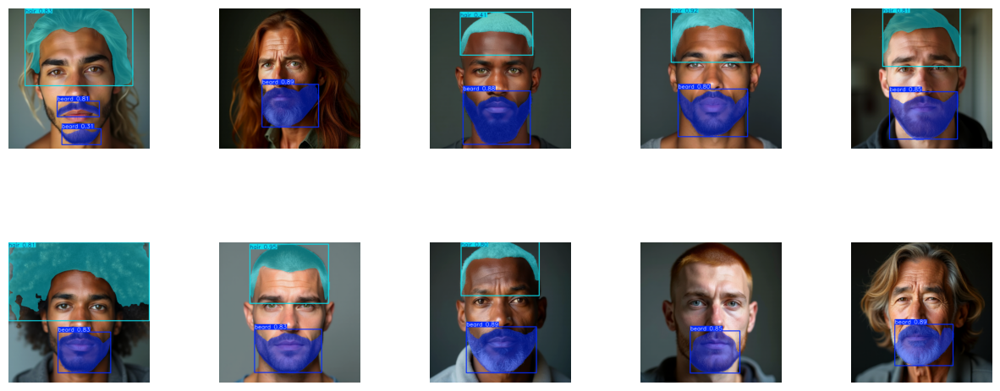

In [7]:
show_image_gird("dataset/dataset/segmentation_results")

### Stage 1.3: Removing Beard From Faces 

At this stage, we will remove beards my using MagicQuill which uses StableDiffusion 1.5 based inpainting and controlnets for edge and color.

In [9]:
from dataset.remove_beard import ImageEdit

masks_path = "dataset/dataset/masks"
image_path = "dataset/dataset/BeardFaces"
imageditor = ImageEdit(masks_path,image_path)
imageditor.forward(limit=1000)

model_type EPS


Line 28, ckpt name:  SD1.5/realisticVisionV60B1_v51VAE.safetensors


Using pytorch attention in VAE
Using pytorch attention in VAE
loaded straight to GPU
Requested to load BaseModel
Loading 1 new model


self.brushnet_loader.inpaint_files:  {'brushnet/random_mask_brushnet_ckpt/diffusion_pytorch_model.safetensors': 'models/inpaint', 'brushnet/segmentation_mask_brushnet_ckpt/diffusion_pytorch_model.safetensors': 'models/inpaint'}
BrushNet model file: models/inpaint/brushnet/random_mask_brushnet_ckpt/diffusion_pytorch_model.safetensors
BrushNet model type: SD1.5
BrushNet model file: models/inpaint/brushnet/random_mask_brushnet_ckpt/diffusion_pytorch_model.safetensors
BrushNet SD1.5 model is loaded


  0%|          | 0/671 [00:00<?, ?it/s]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet


/home/oguzhan/Desktop/BeardRemoval/dataset/MagicQuill/pidi.py:334: UserWarning: The torch.cuda.*DtypeTensor constructors are no longer recommended. It's best to use methods such as torch.tensor(data, dtype=*, device='cuda') to create tensors. (Triggered internally at ../torch/csrc/tensor/python_tensor.cpp:83.)
  buffer = torch.cuda.FloatTensor(shape[0], shape[1], 5 * 5).fill_(0)
Requested to load AutoencoderKL
Loading 1 new model


Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Requested to load ControlNet
Loading 2 new models
/home/oguzhan/Desktop/BeardRemoval/.venv/lib/python3.10/site-packages/diffusers/models/resnet.py:323: FutureWarning: `scale` is deprecated and will be removed in version 1.0.0. The `scale` argument is deprecated and will be ignored. Please remove it, as passing it will raise an error in the future. `scale` should directly be passed while calling the underlying pipeline component i.e., via `cross_attention_kwargs`.
  deprecate("scale", "1.0.0", deprecation_message)


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  8.47it/s]
Requested to load AutoencoderKL
Loading 1 new model
  0%|          | 1/671 [00:03<43:21,  3.88s/it]

Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.22it/s]
Requested to load AutoencoderKL
Loading 1 new model
  0%|          | 2/671 [00:06<34:39,  3.11s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  0%|          | 3/671 [00:08<30:56,  2.78s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.23it/s]
Requested to load AutoencoderKL
Loading 1 new model
  1%|          | 4/671 [00:11<29:28,  2.65s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  1%|          | 5/671 [00:13<28:28,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.11it/s]
Requested to load AutoencoderKL
Loading 1 new model
  1%|          | 6/671 [00:16<28:13,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  1%|          | 7/671 [00:18<27:47,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.99it/s]
Requested to load AutoencoderKL
Loading 1 new model
  1%|          | 8/671 [00:21<27:43,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  1%|▏         | 9/671 [00:23<27:26,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.81it/s]
Requested to load AutoencoderKL
Loading 1 new model
  1%|▏         | 10/671 [00:26<27:35,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  2%|▏         | 11/671 [00:28<27:29,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.86it/s]
Requested to load AutoencoderKL
Loading 1 new model
  2%|▏         | 12/671 [00:31<27:44,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  2%|▏         | 13/671 [00:33<27:45,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.01it/s]
Requested to load AutoencoderKL
Loading 1 new model
  2%|▏         | 14/671 [00:36<27:42,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  2%|▏         | 15/671 [00:38<27:14,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.20it/s]
Requested to load AutoencoderKL
Loading 1 new model
  2%|▏         | 16/671 [00:41<27:03,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  3%|▎         | 17/671 [00:43<26:49,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.86it/s]
Requested to load AutoencoderKL
Loading 1 new model
  3%|▎         | 18/671 [00:46<27:02,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  3%|▎         | 19/671 [00:48<26:46,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.84it/s]
Requested to load AutoencoderKL
Loading 1 new model
  3%|▎         | 20/671 [00:51<26:55,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  3%|▎         | 21/671 [00:53<26:49,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.92it/s]
Requested to load AutoencoderKL
Loading 1 new model
  3%|▎         | 22/671 [00:56<26:59,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  3%|▎         | 23/671 [00:58<27:11,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  8.97it/s]
Requested to load AutoencoderKL
Loading 1 new model
  4%|▎         | 24/671 [01:01<28:03,  2.60s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  4%|▎         | 25/671 [01:04<28:15,  2.62s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  8.94it/s]
Requested to load AutoencoderKL
Loading 1 new model
  4%|▍         | 26/671 [01:06<28:35,  2.66s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  4%|▍         | 27/671 [01:09<28:29,  2.66s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.25it/s]
Requested to load AutoencoderKL
Loading 1 new model
  4%|▍         | 28/671 [01:12<28:34,  2.67s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  4%|▍         | 29/671 [01:14<28:16,  2.64s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.42it/s]
Requested to load AutoencoderKL
Loading 1 new model
  4%|▍         | 30/671 [01:17<28:11,  2.64s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  5%|▍         | 31/671 [01:19<28:04,  2.63s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.28it/s]
Requested to load AutoencoderKL
Loading 1 new model
  5%|▍         | 32/671 [01:22<28:14,  2.65s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  5%|▍         | 33/671 [01:25<28:03,  2.64s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.13it/s]
Requested to load AutoencoderKL
Loading 1 new model
  5%|▌         | 34/671 [01:28<28:19,  2.67s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  5%|▌         | 35/671 [01:30<28:28,  2.69s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.00it/s]
Requested to load AutoencoderKL
Loading 1 new model
  5%|▌         | 36/671 [01:33<28:43,  2.71s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  6%|▌         | 37/671 [01:36<28:35,  2.71s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.29it/s]
Requested to load AutoencoderKL
Loading 1 new model
  6%|▌         | 38/671 [01:38<28:26,  2.70s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  6%|▌         | 39/671 [01:41<27:56,  2.65s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.92it/s]
Requested to load AutoencoderKL
Loading 1 new model
  6%|▌         | 40/671 [01:43<27:24,  2.61s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  6%|▌         | 41/671 [01:46<27:08,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.58it/s]
Requested to load AutoencoderKL
Loading 1 new model
  6%|▋         | 42/671 [01:49<27:10,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  6%|▋         | 43/671 [01:51<26:56,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.77it/s]
Requested to load AutoencoderKL
Loading 1 new model
  7%|▋         | 44/671 [01:54<26:48,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  7%|▋         | 45/671 [01:56<26:29,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.85it/s]
Requested to load AutoencoderKL
Loading 1 new model
  7%|▋         | 46/671 [01:59<26:29,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  7%|▋         | 47/671 [02:01<26:21,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.76it/s]
Requested to load AutoencoderKL
Loading 1 new model
  7%|▋         | 48/671 [02:04<26:24,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  7%|▋         | 49/671 [02:06<26:14,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.66it/s]
Requested to load AutoencoderKL
Loading 1 new model
  7%|▋         | 50/671 [02:09<26:32,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  8%|▊         | 51/671 [02:11<26:20,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.79it/s]
Requested to load AutoencoderKL
Loading 1 new model
  8%|▊         | 52/671 [02:14<26:18,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  8%|▊         | 53/671 [02:17<26:09,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.94it/s]
Requested to load AutoencoderKL
Loading 1 new model
  8%|▊         | 54/671 [02:19<26:02,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  8%|▊         | 55/671 [02:21<25:39,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.85it/s]
Requested to load AutoencoderKL
Loading 1 new model
  8%|▊         | 56/671 [02:24<25:44,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  8%|▊         | 57/671 [02:26<25:24,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.27it/s]
Requested to load AutoencoderKL
Loading 1 new model
  9%|▊         | 58/671 [02:29<25:24,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  9%|▉         | 59/671 [02:31<25:03,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.20it/s]
Requested to load AutoencoderKL
Loading 1 new model
  9%|▉         | 60/671 [02:34<25:00,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  9%|▉         | 61/671 [02:36<25:02,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.10it/s]
Requested to load AutoencoderKL
Loading 1 new model
  9%|▉         | 62/671 [02:39<25:00,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


  9%|▉         | 63/671 [02:41<25:02,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.97it/s]
Requested to load AutoencoderKL
Loading 1 new model
 10%|▉         | 64/671 [02:44<25:02,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 10%|▉         | 65/671 [02:46<25:08,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.67it/s]
Requested to load AutoencoderKL
Loading 1 new model
 10%|▉         | 66/671 [02:49<25:21,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 10%|▉         | 67/671 [02:51<25:20,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.69it/s]
Requested to load AutoencoderKL
Loading 1 new model
 10%|█         | 68/671 [02:54<25:28,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 10%|█         | 69/671 [02:56<25:24,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.73it/s]
Requested to load AutoencoderKL
Loading 1 new model
 10%|█         | 70/671 [02:59<25:27,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 11%|█         | 71/671 [03:01<25:19,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.68it/s]
Requested to load AutoencoderKL
Loading 1 new model
 11%|█         | 72/671 [03:04<25:26,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 11%|█         | 73/671 [03:07<25:20,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.58it/s]
Requested to load AutoencoderKL
Loading 1 new model
 11%|█         | 74/671 [03:09<25:33,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 11%|█         | 75/671 [03:12<25:23,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.66it/s]
Requested to load AutoencoderKL
Loading 1 new model
 11%|█▏        | 76/671 [03:14<25:26,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 11%|█▏        | 77/671 [03:17<25:14,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.61it/s]
Requested to load AutoencoderKL
Loading 1 new model
 12%|█▏        | 78/671 [03:19<25:23,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 12%|█▏        | 79/671 [03:22<25:13,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.60it/s]
Requested to load AutoencoderKL
Loading 1 new model
 12%|█▏        | 80/671 [03:25<25:18,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 12%|█▏        | 81/671 [03:27<25:19,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.70it/s]
Requested to load AutoencoderKL
Loading 1 new model
 12%|█▏        | 82/671 [03:30<25:18,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 12%|█▏        | 83/671 [03:32<25:08,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.37it/s]
Requested to load AutoencoderKL
Loading 1 new model
 13%|█▎        | 84/671 [03:35<25:28,  2.60s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 13%|█▎        | 85/671 [03:38<25:26,  2.60s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.40it/s]
Requested to load AutoencoderKL
Loading 1 new model
 13%|█▎        | 86/671 [03:40<25:40,  2.63s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 13%|█▎        | 87/671 [03:43<25:31,  2.62s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.58it/s]
Requested to load AutoencoderKL
Loading 1 new model
 13%|█▎        | 88/671 [03:45<25:28,  2.62s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 13%|█▎        | 89/671 [03:48<25:14,  2.60s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.51it/s]
Requested to load AutoencoderKL
Loading 1 new model
 13%|█▎        | 90/671 [03:51<25:18,  2.61s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 14%|█▎        | 91/671 [03:53<25:03,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.54it/s]
Requested to load AutoencoderKL
Loading 1 new model
 14%|█▎        | 92/671 [03:56<25:06,  2.60s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 14%|█▍        | 93/671 [03:58<24:51,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.60it/s]
Requested to load AutoencoderKL
Loading 1 new model
 14%|█▍        | 94/671 [04:01<24:50,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 14%|█▍        | 95/671 [04:04<24:38,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.57it/s]
Requested to load AutoencoderKL
Loading 1 new model
 14%|█▍        | 96/671 [04:06<24:47,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 14%|█▍        | 97/671 [04:09<24:38,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.50it/s]
Requested to load AutoencoderKL
Loading 1 new model
 15%|█▍        | 98/671 [04:11<24:44,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 15%|█▍        | 99/671 [04:14<24:29,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.72it/s]
Requested to load AutoencoderKL
Loading 1 new model
 15%|█▍        | 100/671 [04:16<24:27,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 15%|█▌        | 101/671 [04:19<24:20,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.76it/s]
Requested to load AutoencoderKL
Loading 1 new model
 15%|█▌        | 102/671 [04:22<24:17,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 15%|█▌        | 103/671 [04:24<24:08,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.67it/s]
Requested to load AutoencoderKL
Loading 1 new model
 15%|█▌        | 104/671 [04:27<24:12,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 16%|█▌        | 105/671 [04:29<24:01,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.62it/s]
Requested to load AutoencoderKL
Loading 1 new model
 16%|█▌        | 106/671 [04:32<24:06,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 16%|█▌        | 107/671 [04:34<24:00,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.63it/s]
Requested to load AutoencoderKL
Loading 1 new model
 16%|█▌        | 108/671 [04:37<24:06,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 16%|█▌        | 109/671 [04:39<23:56,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.70it/s]
Requested to load AutoencoderKL
Loading 1 new model
 16%|█▋        | 110/671 [04:42<23:56,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 17%|█▋        | 111/671 [04:44<23:44,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.70it/s]
Requested to load AutoencoderKL
Loading 1 new model
 17%|█▋        | 112/671 [04:47<23:46,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 17%|█▋        | 113/671 [04:50<23:41,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.76it/s]
Requested to load AutoencoderKL
Loading 1 new model
 17%|█▋        | 114/671 [04:52<23:41,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 17%|█▋        | 115/671 [04:55<23:34,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.64it/s]
Requested to load AutoencoderKL
Loading 1 new model
 17%|█▋        | 116/671 [04:57<23:39,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 17%|█▋        | 117/671 [05:00<23:29,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.71it/s]
Requested to load AutoencoderKL
Loading 1 new model
 18%|█▊        | 118/671 [05:02<23:29,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 18%|█▊        | 119/671 [05:05<23:19,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.74it/s]
Requested to load AutoencoderKL
Loading 1 new model
 18%|█▊        | 120/671 [05:07<23:23,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 18%|█▊        | 121/671 [05:10<23:13,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.71it/s]
Requested to load AutoencoderKL
Loading 1 new model
 18%|█▊        | 122/671 [05:12<23:16,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 18%|█▊        | 123/671 [05:15<23:10,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.79it/s]
Requested to load AutoencoderKL
Loading 1 new model
 18%|█▊        | 124/671 [05:18<23:12,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 19%|█▊        | 125/671 [05:20<23:03,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.70it/s]
Requested to load AutoencoderKL
Loading 1 new model
 19%|█▉        | 126/671 [05:23<23:07,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 19%|█▉        | 127/671 [05:25<22:59,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.71it/s]
Requested to load AutoencoderKL
Loading 1 new model
 19%|█▉        | 128/671 [05:28<23:04,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 19%|█▉        | 129/671 [05:30<22:55,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.72it/s]
Requested to load AutoencoderKL
Loading 1 new model
 19%|█▉        | 130/671 [05:33<22:58,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 20%|█▉        | 131/671 [05:35<22:58,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.56it/s]
Requested to load AutoencoderKL
Loading 1 new model
 20%|█▉        | 132/671 [05:38<23:05,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 20%|█▉        | 133/671 [05:41<22:58,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.61it/s]
Requested to load AutoencoderKL
Loading 1 new model
 20%|█▉        | 134/671 [05:43<23:05,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 20%|██        | 135/671 [05:46<22:53,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.63it/s]
Requested to load AutoencoderKL
Loading 1 new model
 20%|██        | 136/671 [05:48<22:59,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 20%|██        | 137/671 [05:51<22:48,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.73it/s]
Requested to load AutoencoderKL
Loading 1 new model
 21%|██        | 138/671 [05:53<22:49,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 21%|██        | 139/671 [05:56<22:36,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.67it/s]
Requested to load AutoencoderKL
Loading 1 new model
 21%|██        | 140/671 [05:58<22:34,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 21%|██        | 141/671 [06:01<22:30,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.65it/s]
Requested to load AutoencoderKL
Loading 1 new model
 21%|██        | 142/671 [06:04<22:35,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 21%|██▏       | 143/671 [06:06<22:29,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.56it/s]
Requested to load AutoencoderKL
Loading 1 new model
 21%|██▏       | 144/671 [06:09<22:35,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 22%|██▏       | 145/671 [06:11<22:27,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.30it/s]
Requested to load AutoencoderKL
Loading 1 new model
 22%|██▏       | 146/671 [06:14<22:08,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 22%|██▏       | 147/671 [06:16<21:48,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.28it/s]
Requested to load AutoencoderKL
Loading 1 new model
 22%|██▏       | 148/671 [06:19<21:34,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 22%|██▏       | 149/671 [06:21<21:20,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.19it/s]
Requested to load AutoencoderKL
Loading 1 new model
 22%|██▏       | 150/671 [06:23<21:16,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 23%|██▎       | 151/671 [06:26<21:08,  2.44s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.38it/s]
Requested to load AutoencoderKL
Loading 1 new model
 23%|██▎       | 152/671 [06:28<21:03,  2.43s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 23%|██▎       | 153/671 [06:31<20:49,  2.41s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.39it/s]
Requested to load AutoencoderKL
Loading 1 new model
 23%|██▎       | 154/671 [06:33<20:45,  2.41s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 23%|██▎       | 155/671 [06:35<20:34,  2.39s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.38it/s]
Requested to load AutoencoderKL
Loading 1 new model
 23%|██▎       | 156/671 [06:38<20:33,  2.39s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 23%|██▎       | 157/671 [06:40<20:23,  2.38s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.40it/s]
Requested to load AutoencoderKL
Loading 1 new model
 24%|██▎       | 158/671 [06:43<20:24,  2.39s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 24%|██▎       | 159/671 [06:45<20:41,  2.42s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.78it/s]
Requested to load AutoencoderKL
Loading 1 new model
 24%|██▍       | 160/671 [06:48<20:57,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 24%|██▍       | 161/671 [06:50<20:58,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.92it/s]
Requested to load AutoencoderKL
Loading 1 new model
 24%|██▍       | 162/671 [06:53<21:05,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 24%|██▍       | 163/671 [06:55<21:04,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.85it/s]
Requested to load AutoencoderKL
Loading 1 new model
 24%|██▍       | 164/671 [06:58<21:08,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 25%|██▍       | 165/671 [07:00<20:58,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.89it/s]
Requested to load AutoencoderKL
Loading 1 new model
 25%|██▍       | 166/671 [07:03<21:00,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 25%|██▍       | 167/671 [07:05<20:49,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.97it/s]
Requested to load AutoencoderKL
Loading 1 new model
 25%|██▌       | 168/671 [07:08<20:53,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 25%|██▌       | 169/671 [07:10<20:35,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.03it/s]
Requested to load AutoencoderKL
Loading 1 new model
 25%|██▌       | 170/671 [07:12<20:36,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 25%|██▌       | 171/671 [07:15<20:25,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.99it/s]
Requested to load AutoencoderKL
Loading 1 new model
 26%|██▌       | 172/671 [07:17<20:33,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 26%|██▌       | 173/671 [07:20<20:24,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.12it/s]
Requested to load AutoencoderKL
Loading 1 new model
 26%|██▌       | 174/671 [07:22<20:25,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 26%|██▌       | 175/671 [07:25<20:12,  2.44s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.07it/s]
Requested to load AutoencoderKL
Loading 1 new model
 26%|██▌       | 176/671 [07:27<20:15,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 26%|██▋       | 177/671 [07:30<20:10,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.12it/s]
Requested to load AutoencoderKL
Loading 1 new model
 27%|██▋       | 178/671 [07:32<20:13,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 27%|██▋       | 179/671 [07:35<20:11,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.10it/s]
Requested to load AutoencoderKL
Loading 1 new model
 27%|██▋       | 180/671 [07:37<20:15,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 27%|██▋       | 181/671 [07:39<20:05,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.88it/s]
Requested to load AutoencoderKL
Loading 1 new model
 27%|██▋       | 182/671 [07:42<20:16,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 27%|██▋       | 183/671 [07:45<20:17,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.97it/s]
Requested to load AutoencoderKL
Loading 1 new model
 27%|██▋       | 184/671 [07:47<20:16,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 28%|██▊       | 185/671 [07:49<19:56,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.14it/s]
Requested to load AutoencoderKL
Loading 1 new model
 28%|██▊       | 186/671 [07:52<19:55,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 28%|██▊       | 187/671 [07:54<20:04,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.67it/s]
Requested to load AutoencoderKL
Loading 1 new model
 28%|██▊       | 188/671 [07:57<20:20,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 28%|██▊       | 189/671 [07:59<20:05,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.70it/s]
Requested to load AutoencoderKL
Loading 1 new model
 28%|██▊       | 190/671 [08:02<20:11,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 28%|██▊       | 191/671 [08:05<19:59,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.03it/s]
Requested to load AutoencoderKL
Loading 1 new model
 29%|██▊       | 192/671 [08:07<19:57,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 29%|██▉       | 193/671 [08:09<19:48,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.77it/s]
Requested to load AutoencoderKL
Loading 1 new model
 29%|██▉       | 194/671 [08:12<19:54,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 29%|██▉       | 195/671 [08:14<19:42,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.61it/s]
Requested to load AutoencoderKL
Loading 1 new model
 29%|██▉       | 196/671 [08:17<19:55,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 29%|██▉       | 197/671 [08:20<19:50,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.99it/s]
Requested to load AutoencoderKL
Loading 1 new model
 30%|██▉       | 198/671 [08:22<19:48,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 30%|██▉       | 199/671 [08:24<19:32,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.11it/s]
Requested to load AutoencoderKL
Loading 1 new model
 30%|██▉       | 200/671 [08:27<19:30,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 30%|██▉       | 201/671 [08:29<19:20,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.93it/s]
Requested to load AutoencoderKL
Loading 1 new model
 30%|███       | 202/671 [08:32<19:24,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 30%|███       | 203/671 [08:34<19:26,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.81it/s]
Requested to load AutoencoderKL
Loading 1 new model
 30%|███       | 204/671 [08:37<19:30,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 31%|███       | 205/671 [08:39<19:26,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.77it/s]
Requested to load AutoencoderKL
Loading 1 new model
 31%|███       | 206/671 [08:42<19:27,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 31%|███       | 207/671 [08:44<19:10,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.28it/s]
Requested to load AutoencoderKL
Loading 1 new model
 31%|███       | 208/671 [08:47<19:00,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 31%|███       | 209/671 [08:49<18:58,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.55it/s]
Requested to load AutoencoderKL
Loading 1 new model
 31%|███▏      | 210/671 [08:52<19:18,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 31%|███▏      | 211/671 [08:55<19:36,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.19it/s]
Requested to load AutoencoderKL
Loading 1 new model
 32%|███▏      | 212/671 [08:57<19:18,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 32%|███▏      | 213/671 [09:00<19:26,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.82it/s]
Requested to load AutoencoderKL
Loading 1 new model
 32%|███▏      | 214/671 [09:02<19:28,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 32%|███▏      | 215/671 [09:05<19:39,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.67it/s]
Requested to load AutoencoderKL
Loading 1 new model
 32%|███▏      | 216/671 [09:07<19:42,  2.60s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 32%|███▏      | 217/671 [09:10<19:37,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.82it/s]
Requested to load AutoencoderKL
Loading 1 new model
 32%|███▏      | 218/671 [09:13<19:32,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 33%|███▎      | 219/671 [09:15<19:05,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.38it/s]
Requested to load AutoencoderKL
Loading 1 new model
 33%|███▎      | 220/671 [09:17<18:44,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 33%|███▎      | 221/671 [09:20<18:25,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.60it/s]
Requested to load AutoencoderKL
Loading 1 new model
 33%|███▎      | 222/671 [09:22<18:36,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 33%|███▎      | 223/671 [09:25<18:21,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.90it/s]
Requested to load AutoencoderKL
Loading 1 new model
 33%|███▎      | 224/671 [09:27<18:26,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 34%|███▎      | 225/671 [09:30<18:15,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.05it/s]
Requested to load AutoencoderKL
Loading 1 new model
 34%|███▎      | 226/671 [09:32<18:20,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 34%|███▍      | 227/671 [09:35<18:19,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.83it/s]
Requested to load AutoencoderKL
Loading 1 new model
 34%|███▍      | 228/671 [09:37<18:26,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 34%|███▍      | 229/671 [09:40<18:35,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.07it/s]
Requested to load AutoencoderKL
Loading 1 new model
 34%|███▍      | 230/671 [09:42<18:27,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 34%|███▍      | 231/671 [09:45<18:31,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.63it/s]
Requested to load AutoencoderKL
Loading 1 new model
 35%|███▍      | 232/671 [09:47<18:36,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 35%|███▍      | 233/671 [09:50<18:45,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.59it/s]
Requested to load AutoencoderKL
Loading 1 new model
 35%|███▍      | 234/671 [09:53<18:47,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 35%|███▌      | 235/671 [09:55<18:26,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.38it/s]
Requested to load AutoencoderKL
Loading 1 new model
 35%|███▌      | 236/671 [09:58<18:34,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 35%|███▌      | 237/671 [10:00<18:42,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.47it/s]
Requested to load AutoencoderKL
Loading 1 new model
 35%|███▌      | 238/671 [10:03<18:41,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 36%|███▌      | 239/671 [10:06<18:27,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.47it/s]
Requested to load AutoencoderKL
Loading 1 new model
 36%|███▌      | 240/671 [10:08<18:38,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 36%|███▌      | 241/671 [10:11<18:29,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.76it/s]
Requested to load AutoencoderKL
Loading 1 new model
 36%|███▌      | 242/671 [10:13<18:29,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 36%|███▌      | 243/671 [10:16<18:03,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.32it/s]
Requested to load AutoencoderKL
Loading 1 new model
 36%|███▋      | 244/671 [10:18<17:45,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 37%|███▋      | 245/671 [10:21<17:29,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.28it/s]
Requested to load AutoencoderKL
Loading 1 new model
 37%|███▋      | 246/671 [10:23<17:23,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 37%|███▋      | 247/671 [10:25<17:13,  2.44s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.11it/s]
Requested to load AutoencoderKL
Loading 1 new model
 37%|███▋      | 248/671 [10:28<17:14,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 37%|███▋      | 249/671 [10:30<17:08,  2.44s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.13it/s]
Requested to load AutoencoderKL
Loading 1 new model
 37%|███▋      | 250/671 [10:33<17:08,  2.44s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 37%|███▋      | 251/671 [10:35<17:01,  2.43s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.12it/s]
Requested to load AutoencoderKL
Loading 1 new model
 38%|███▊      | 252/671 [10:38<17:01,  2.44s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 38%|███▊      | 253/671 [10:40<16:50,  2.42s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.19it/s]
Requested to load AutoencoderKL
Loading 1 new model
 38%|███▊      | 254/671 [10:42<16:51,  2.43s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 38%|███▊      | 255/671 [10:45<16:51,  2.43s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.24it/s]
Requested to load AutoencoderKL
Loading 1 new model
 38%|███▊      | 256/671 [10:47<16:51,  2.44s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 38%|███▊      | 257/671 [10:50<16:43,  2.42s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.96it/s]
Requested to load AutoencoderKL
Loading 1 new model
 38%|███▊      | 258/671 [10:52<16:53,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 39%|███▊      | 259/671 [10:55<16:51,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.24it/s]
Requested to load AutoencoderKL
Loading 1 new model
 39%|███▊      | 260/671 [10:57<16:47,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 39%|███▉      | 261/671 [10:59<16:33,  2.42s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.37it/s]
Requested to load AutoencoderKL
Loading 1 new model
 39%|███▉      | 262/671 [11:02<16:28,  2.42s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 39%|███▉      | 263/671 [11:04<16:18,  2.40s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.35it/s]
Requested to load AutoencoderKL
Loading 1 new model
 39%|███▉      | 264/671 [11:07<16:17,  2.40s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 39%|███▉      | 265/671 [11:09<16:08,  2.39s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.35it/s]
Requested to load AutoencoderKL
Loading 1 new model
 40%|███▉      | 266/671 [11:11<16:09,  2.39s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 40%|███▉      | 267/671 [11:14<16:01,  2.38s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.19it/s]
Requested to load AutoencoderKL
Loading 1 new model
 40%|███▉      | 268/671 [11:16<16:07,  2.40s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 40%|████      | 269/671 [11:19<15:58,  2.38s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.33it/s]
Requested to load AutoencoderKL
Loading 1 new model
 40%|████      | 270/671 [11:21<15:59,  2.39s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 40%|████      | 271/671 [11:23<15:57,  2.39s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.10it/s]
Requested to load AutoencoderKL
Loading 1 new model
 41%|████      | 272/671 [11:26<16:01,  2.41s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 41%|████      | 273/671 [11:28<15:58,  2.41s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.40it/s]
Requested to load AutoencoderKL
Loading 1 new model
 41%|████      | 274/671 [11:31<15:53,  2.40s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 41%|████      | 275/671 [11:33<15:44,  2.39s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00, 10.00it/s]
Requested to load AutoencoderKL
Loading 1 new model
 41%|████      | 276/671 [11:35<15:57,  2.42s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 41%|████▏     | 277/671 [11:38<15:53,  2.42s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.34it/s]
Requested to load AutoencoderKL
Loading 1 new model
 41%|████▏     | 278/671 [11:40<15:52,  2.42s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 42%|████▏     | 279/671 [11:43<15:45,  2.41s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.80it/s]
Requested to load AutoencoderKL
Loading 1 new model
 42%|████▏     | 280/671 [11:45<15:55,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 42%|████▏     | 281/671 [11:48<15:57,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.17it/s]
Requested to load AutoencoderKL
Loading 1 new model
 42%|████▏     | 282/671 [11:50<15:54,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 42%|████▏     | 283/671 [11:52<15:40,  2.42s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.38it/s]
Requested to load AutoencoderKL
Loading 1 new model
 42%|████▏     | 284/671 [11:55<15:34,  2.41s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 42%|████▏     | 285/671 [11:57<15:25,  2.40s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.37it/s]
Requested to load AutoencoderKL
Loading 1 new model
 43%|████▎     | 286/671 [12:00<15:24,  2.40s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 43%|████▎     | 287/671 [12:02<15:15,  2.38s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.42it/s]
Requested to load AutoencoderKL
Loading 1 new model
 43%|████▎     | 288/671 [12:04<15:13,  2.39s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 43%|████▎     | 289/671 [12:07<15:05,  2.37s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.31it/s]
Requested to load AutoencoderKL
Loading 1 new model
 43%|████▎     | 290/671 [12:09<15:08,  2.39s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 43%|████▎     | 291/671 [12:12<15:10,  2.40s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.14it/s]
Requested to load AutoencoderKL
Loading 1 new model
 44%|████▎     | 292/671 [12:14<15:15,  2.42s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 44%|████▎     | 293/671 [12:16<15:18,  2.43s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.68it/s]
Requested to load AutoencoderKL
Loading 1 new model
 44%|████▍     | 294/671 [12:19<15:32,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 44%|████▍     | 295/671 [12:22<15:38,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.22it/s]
Requested to load AutoencoderKL
Loading 1 new model
 44%|████▍     | 296/671 [12:24<15:32,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 44%|████▍     | 297/671 [12:26<15:23,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.88it/s]
Requested to load AutoencoderKL
Loading 1 new model
 44%|████▍     | 298/671 [12:29<15:27,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 45%|████▍     | 299/671 [12:31<15:26,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.06it/s]
Requested to load AutoencoderKL
Loading 1 new model
 45%|████▍     | 300/671 [12:34<15:22,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 45%|████▍     | 301/671 [12:36<15:08,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.94it/s]
Requested to load AutoencoderKL
Loading 1 new model
 45%|████▌     | 302/671 [12:39<15:11,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 45%|████▌     | 303/671 [12:41<15:02,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.04it/s]
Requested to load AutoencoderKL
Loading 1 new model
 45%|████▌     | 304/671 [12:44<15:03,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 45%|████▌     | 305/671 [12:46<14:59,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.04it/s]
Requested to load AutoencoderKL
Loading 1 new model
 46%|████▌     | 306/671 [12:49<14:59,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 46%|████▌     | 307/671 [12:51<14:51,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.30it/s]
Requested to load AutoencoderKL
Loading 1 new model
 46%|████▌     | 308/671 [12:54<14:45,  2.44s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 46%|████▌     | 309/671 [12:56<14:40,  2.43s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.78it/s]
Requested to load AutoencoderKL
Loading 1 new model
 46%|████▌     | 310/671 [12:58<14:50,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 46%|████▋     | 311/671 [13:01<14:50,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.96it/s]
Requested to load AutoencoderKL
Loading 1 new model
 46%|████▋     | 312/671 [13:03<14:52,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 47%|████▋     | 313/671 [13:06<14:47,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.92it/s]
Requested to load AutoencoderKL
Loading 1 new model
 47%|████▋     | 314/671 [13:08<14:48,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 47%|████▋     | 315/671 [13:11<14:45,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.98it/s]
Requested to load AutoencoderKL
Loading 1 new model
 47%|████▋     | 316/671 [13:13<14:44,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 47%|████▋     | 317/671 [13:16<14:39,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.89it/s]
Requested to load AutoencoderKL
Loading 1 new model
 47%|████▋     | 318/671 [13:18<14:40,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 48%|████▊     | 319/671 [13:21<14:40,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.62it/s]
Requested to load AutoencoderKL
Loading 1 new model
 48%|████▊     | 320/671 [13:24<14:46,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 48%|████▊     | 321/671 [13:26<14:41,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.85it/s]
Requested to load AutoencoderKL
Loading 1 new model
 48%|████▊     | 322/671 [13:29<14:41,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 48%|████▊     | 323/671 [13:31<14:37,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.44it/s]
Requested to load AutoencoderKL
Loading 1 new model
 48%|████▊     | 324/671 [13:34<14:49,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 48%|████▊     | 325/671 [13:36<14:50,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.32it/s]
Requested to load AutoencoderKL
Loading 1 new model
 49%|████▊     | 326/671 [13:39<14:56,  2.60s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 49%|████▊     | 327/671 [13:42<14:51,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.46it/s]
Requested to load AutoencoderKL
Loading 1 new model
 49%|████▉     | 328/671 [13:44<14:56,  2.61s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 49%|████▉     | 329/671 [13:47<14:51,  2.61s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.74it/s]
Requested to load AutoencoderKL
Loading 1 new model
 49%|████▉     | 330/671 [13:49<14:45,  2.60s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 49%|████▉     | 331/671 [13:52<14:33,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.38it/s]
Requested to load AutoencoderKL
Loading 1 new model
 49%|████▉     | 332/671 [13:55<14:40,  2.60s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 50%|████▉     | 333/671 [13:57<14:33,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.46it/s]
Requested to load AutoencoderKL
Loading 1 new model
 50%|████▉     | 334/671 [14:00<14:40,  2.61s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model



BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 50%|████▉     | 335/671 [14:02<14:44,  2.63s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.49it/s]
Requested to load AutoencoderKL
Loading 1 new model
 50%|█████     | 336/671 [14:05<14:43,  2.64s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 50%|█████     | 337/671 [14:08<14:32,  2.61s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.18it/s]
Requested to load AutoencoderKL
Loading 1 new model
 50%|█████     | 338/671 [14:10<14:40,  2.64s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 51%|█████     | 339/671 [14:13<14:33,  2.63s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.42it/s]
Requested to load AutoencoderKL
Loading 1 new model
 51%|█████     | 340/671 [14:16<14:33,  2.64s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 51%|█████     | 341/671 [14:18<14:24,  2.62s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.47it/s]
Requested to load AutoencoderKL
Loading 1 new model
 51%|█████     | 342/671 [14:21<14:24,  2.63s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 51%|█████     | 343/671 [14:23<14:16,  2.61s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.44it/s]
Requested to load AutoencoderKL
Loading 1 new model
 51%|█████▏    | 344/671 [14:26<14:17,  2.62s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 51%|█████▏    | 345/671 [14:29<14:05,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.02it/s]
Requested to load AutoencoderKL
Loading 1 new model
 52%|█████▏    | 346/671 [14:31<13:53,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 52%|█████▏    | 347/671 [14:34<13:37,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.04it/s]
Requested to load AutoencoderKL
Loading 1 new model
 52%|█████▏    | 348/671 [14:36<13:31,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 52%|█████▏    | 349/671 [14:38<13:20,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.05it/s]
Requested to load AutoencoderKL
Loading 1 new model
 52%|█████▏    | 350/671 [14:41<13:17,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 52%|█████▏    | 351/671 [14:43<13:12,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.03it/s]
Requested to load AutoencoderKL
Loading 1 new model
 52%|█████▏    | 352/671 [14:46<13:11,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 53%|█████▎    | 353/671 [14:48<13:04,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.04it/s]
Requested to load AutoencoderKL
Loading 1 new model
 53%|█████▎    | 354/671 [14:51<13:04,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 53%|█████▎    | 355/671 [14:53<12:57,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.06it/s]
Requested to load AutoencoderKL
Loading 1 new model
 53%|█████▎    | 356/671 [14:56<12:57,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 53%|█████▎    | 357/671 [14:58<12:50,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.05it/s]
Requested to load AutoencoderKL
Loading 1 new model
 53%|█████▎    | 358/671 [15:01<12:50,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 54%|█████▎    | 359/671 [15:03<12:45,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.03it/s]
Requested to load AutoencoderKL
Loading 1 new model
 54%|█████▎    | 360/671 [15:06<12:46,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 54%|█████▍    | 361/671 [15:08<12:41,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.01it/s]
Requested to load AutoencoderKL
Loading 1 new model
 54%|█████▍    | 362/671 [15:10<12:42,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 54%|█████▍    | 363/671 [15:13<12:36,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.05it/s]
Requested to load AutoencoderKL
Loading 1 new model
 54%|█████▍    | 364/671 [15:15<12:36,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 54%|█████▍    | 365/671 [15:18<12:31,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.02it/s]
Requested to load AutoencoderKL
Loading 1 new model
 55%|█████▍    | 366/671 [15:20<12:35,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 55%|█████▍    | 367/671 [15:23<12:27,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.02it/s]
Requested to load AutoencoderKL
Loading 1 new model
 55%|█████▍    | 368/671 [15:25<12:28,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 55%|█████▍    | 369/671 [15:28<12:21,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.06it/s]
Requested to load AutoencoderKL
Loading 1 new model
 55%|█████▌    | 370/671 [15:30<12:22,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 55%|█████▌    | 371/671 [15:33<12:16,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.05it/s]
Requested to load AutoencoderKL
Loading 1 new model
 55%|█████▌    | 372/671 [15:35<12:16,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 56%|█████▌    | 373/671 [15:38<12:11,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.04it/s]
Requested to load AutoencoderKL
Loading 1 new model
 56%|█████▌    | 374/671 [15:40<12:13,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 56%|█████▌    | 375/671 [15:42<12:06,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.02it/s]
Requested to load AutoencoderKL
Loading 1 new model
 56%|█████▌    | 376/671 [15:45<12:06,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 56%|█████▌    | 377/671 [15:47<12:01,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.95it/s]
Requested to load AutoencoderKL
Loading 1 new model
 56%|█████▋    | 378/671 [15:50<12:03,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 56%|█████▋    | 379/671 [15:52<11:58,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.97it/s]
Requested to load AutoencoderKL
Loading 1 new model
 57%|█████▋    | 380/671 [15:55<11:59,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 57%|█████▋    | 381/671 [15:57<11:53,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00, 10.00it/s]
Requested to load AutoencoderKL
Loading 1 new model
 57%|█████▋    | 382/671 [16:00<11:55,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 57%|█████▋    | 383/671 [16:02<11:50,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.95it/s]
Requested to load AutoencoderKL
Loading 1 new model
 57%|█████▋    | 384/671 [16:05<11:50,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 57%|█████▋    | 385/671 [16:07<11:45,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.97it/s]
Requested to load AutoencoderKL
Loading 1 new model
 58%|█████▊    | 386/671 [16:10<11:44,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 58%|█████▊    | 387/671 [16:12<11:39,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.98it/s]
Requested to load AutoencoderKL
Loading 1 new model
 58%|█████▊    | 388/671 [16:15<11:40,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 58%|█████▊    | 389/671 [16:17<11:34,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.99it/s]
Requested to load AutoencoderKL
Loading 1 new model
 58%|█████▊    | 390/671 [16:20<11:34,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 58%|█████▊    | 391/671 [16:22<11:29,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.99it/s]
Requested to load AutoencoderKL
Loading 1 new model
 58%|█████▊    | 392/671 [16:24<11:31,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 59%|█████▊    | 393/671 [16:27<11:25,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.02it/s]
Requested to load AutoencoderKL
Loading 1 new model
 59%|█████▊    | 394/671 [16:29<11:25,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 59%|█████▉    | 395/671 [16:32<11:20,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.99it/s]
Requested to load AutoencoderKL
Loading 1 new model
 59%|█████▉    | 396/671 [16:34<11:20,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 59%|█████▉    | 397/671 [16:37<11:15,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.02it/s]
Requested to load AutoencoderKL
Loading 1 new model
 59%|█████▉    | 398/671 [16:39<11:15,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 59%|█████▉    | 399/671 [16:42<11:11,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.80it/s]
Requested to load AutoencoderKL
Loading 1 new model
 60%|█████▉    | 400/671 [16:44<11:15,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 60%|█████▉    | 401/671 [16:47<11:11,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.81it/s]
Requested to load AutoencoderKL
Loading 1 new model
 60%|█████▉    | 402/671 [16:49<11:14,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 60%|██████    | 403/671 [16:52<11:11,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.78it/s]
Requested to load AutoencoderKL
Loading 1 new model
 60%|██████    | 404/671 [16:54<11:12,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 60%|██████    | 405/671 [16:57<11:07,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.80it/s]
Requested to load AutoencoderKL
Loading 1 new model
 61%|██████    | 406/671 [16:59<11:07,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 61%|██████    | 407/671 [17:02<11:02,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.96it/s]
Requested to load AutoencoderKL
Loading 1 new model
 61%|██████    | 408/671 [17:04<11:00,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 61%|██████    | 409/671 [17:07<10:53,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.99it/s]
Requested to load AutoencoderKL
Loading 1 new model
 61%|██████    | 410/671 [17:09<10:52,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 61%|██████▏   | 411/671 [17:12<10:47,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.89it/s]
Requested to load AutoencoderKL
Loading 1 new model
 61%|██████▏   | 412/671 [17:14<10:48,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 62%|██████▏   | 413/671 [17:17<10:42,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.97it/s]
Requested to load AutoencoderKL
Loading 1 new model
 62%|██████▏   | 414/671 [17:19<10:40,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 62%|██████▏   | 415/671 [17:22<10:34,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00, 10.00it/s]
Requested to load AutoencoderKL
Loading 1 new model
 62%|██████▏   | 416/671 [17:24<10:33,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 62%|██████▏   | 417/671 [17:27<10:29,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.87it/s]
Requested to load AutoencoderKL
Loading 1 new model
 62%|██████▏   | 418/671 [17:29<10:32,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 62%|██████▏   | 419/671 [17:32<10:27,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.87it/s]
Requested to load AutoencoderKL
Loading 1 new model
 63%|██████▎   | 420/671 [17:34<10:27,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 63%|██████▎   | 421/671 [17:37<10:21,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.87it/s]
Requested to load AutoencoderKL
Loading 1 new model
 63%|██████▎   | 422/671 [17:39<10:22,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 63%|██████▎   | 423/671 [17:42<10:17,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet


Requested to load BaseModel
Loading 1 new model


Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.88it/s]
Requested to load AutoencoderKL
Loading 1 new model
 63%|██████▎   | 424/671 [17:44<10:32,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 63%|██████▎   | 425/671 [17:47<10:23,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.88it/s]
Requested to load AutoencoderKL
Loading 1 new model
 63%|██████▎   | 426/671 [17:49<10:20,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 64%|██████▎   | 427/671 [17:52<10:12,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.84it/s]
Requested to load AutoencoderKL
Loading 1 new model
 64%|██████▍   | 428/671 [17:54<10:11,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 64%|██████▍   | 429/671 [17:57<10:05,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.86it/s]
Requested to load AutoencoderKL
Loading 1 new model
 64%|██████▍   | 430/671 [17:59<10:04,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 64%|██████▍   | 431/671 [18:02<09:59,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.92it/s]
Requested to load AutoencoderKL
Loading 1 new model
 64%|██████▍   | 432/671 [18:04<09:57,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 65%|██████▍   | 433/671 [18:07<09:49,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.03it/s]
Requested to load AutoencoderKL
Loading 1 new model
 65%|██████▍   | 434/671 [18:09<09:47,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 65%|██████▍   | 435/671 [18:12<09:40,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.06it/s]
Requested to load AutoencoderKL
Loading 1 new model
 65%|██████▍   | 436/671 [18:14<09:40,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 65%|██████▌   | 437/671 [18:17<09:34,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.03it/s]
Requested to load AutoencoderKL
Loading 1 new model
 65%|██████▌   | 438/671 [18:19<09:34,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 65%|██████▌   | 439/671 [18:22<09:28,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.08it/s]
Requested to load AutoencoderKL
Loading 1 new model
 66%|██████▌   | 440/671 [18:24<09:28,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 66%|██████▌   | 441/671 [18:26<09:23,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.08it/s]
Requested to load AutoencoderKL
Loading 1 new model
 66%|██████▌   | 442/671 [18:29<09:23,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 66%|██████▌   | 443/671 [18:31<09:19,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.10it/s]
Requested to load AutoencoderKL
Loading 1 new model
 66%|██████▌   | 444/671 [18:34<09:17,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 66%|██████▋   | 445/671 [18:36<09:12,  2.44s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.06it/s]
Requested to load AutoencoderKL
Loading 1 new model
 66%|██████▋   | 446/671 [18:39<09:12,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 67%|██████▋   | 447/671 [18:41<09:08,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.08it/s]
Requested to load AutoencoderKL
Loading 1 new model
 67%|██████▋   | 448/671 [18:44<09:08,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 67%|██████▋   | 449/671 [18:46<09:04,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.07it/s]
Requested to load AutoencoderKL
Loading 1 new model
 67%|██████▋   | 450/671 [18:49<09:03,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 67%|██████▋   | 451/671 [18:51<08:59,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.09it/s]
Requested to load AutoencoderKL
Loading 1 new model
 67%|██████▋   | 452/671 [18:53<08:58,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 68%|██████▊   | 453/671 [18:56<08:53,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.03it/s]
Requested to load AutoencoderKL
Loading 1 new model
 68%|██████▊   | 454/671 [18:58<08:53,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 68%|██████▊   | 455/671 [19:01<08:49,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.08it/s]
Requested to load AutoencoderKL
Loading 1 new model
 68%|██████▊   | 456/671 [19:03<08:48,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 68%|██████▊   | 457/671 [19:06<08:44,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.05it/s]
Requested to load AutoencoderKL
Loading 1 new model
 68%|██████▊   | 458/671 [19:08<08:43,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 68%|██████▊   | 459/671 [19:11<08:39,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.03it/s]
Requested to load AutoencoderKL
Loading 1 new model
 69%|██████▊   | 460/671 [19:13<08:38,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 69%|██████▊   | 461/671 [19:16<08:35,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.07it/s]
Requested to load AutoencoderKL
Loading 1 new model
 69%|██████▉   | 462/671 [19:18<08:34,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 69%|██████▉   | 463/671 [19:20<08:29,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.02it/s]
Requested to load AutoencoderKL
Loading 1 new model
 69%|██████▉   | 464/671 [19:23<08:30,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 69%|██████▉   | 465/671 [19:25<08:25,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.01it/s]
Requested to load AutoencoderKL
Loading 1 new model
 69%|██████▉   | 466/671 [19:28<08:25,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 70%|██████▉   | 467/671 [19:30<08:21,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.05it/s]
Requested to load AutoencoderKL
Loading 1 new model
 70%|██████▉   | 468/671 [19:33<08:20,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 70%|██████▉   | 469/671 [19:35<08:15,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.02it/s]
Requested to load AutoencoderKL
Loading 1 new model
 70%|███████   | 470/671 [19:38<08:15,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 70%|███████   | 471/671 [19:40<08:10,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.00it/s]
Requested to load AutoencoderKL
Loading 1 new model
 70%|███████   | 472/671 [19:43<08:10,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 70%|███████   | 473/671 [19:45<08:05,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.99it/s]
Requested to load AutoencoderKL
Loading 1 new model
 71%|███████   | 474/671 [19:48<08:06,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 71%|███████   | 475/671 [19:50<08:01,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.98it/s]
Requested to load AutoencoderKL
Loading 1 new model
 71%|███████   | 476/671 [19:53<08:01,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 71%|███████   | 477/671 [19:55<07:57,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.03it/s]
Requested to load AutoencoderKL
Loading 1 new model
 71%|███████   | 478/671 [19:57<07:56,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 71%|███████▏  | 479/671 [20:00<07:52,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.97it/s]
Requested to load AutoencoderKL
Loading 1 new model
 72%|███████▏  | 480/671 [20:02<07:51,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 72%|███████▏  | 481/671 [20:05<07:48,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.99it/s]
Requested to load AutoencoderKL
Loading 1 new model
 72%|███████▏  | 482/671 [20:07<07:47,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 72%|███████▏  | 483/671 [20:10<07:43,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.96it/s]
Requested to load AutoencoderKL
Loading 1 new model
 72%|███████▏  | 484/671 [20:12<07:43,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 72%|███████▏  | 485/671 [20:15<07:39,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.02it/s]
Requested to load AutoencoderKL
Loading 1 new model
 72%|███████▏  | 486/671 [20:17<07:37,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 73%|███████▎  | 487/671 [20:20<07:34,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.01it/s]
Requested to load AutoencoderKL
Loading 1 new model
 73%|███████▎  | 488/671 [20:22<07:32,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 73%|███████▎  | 489/671 [20:25<07:28,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.87it/s]
Requested to load AutoencoderKL
Loading 1 new model
 73%|███████▎  | 490/671 [20:27<07:28,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 73%|███████▎  | 491/671 [20:30<07:26,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.85it/s]
Requested to load AutoencoderKL
Loading 1 new model
 73%|███████▎  | 492/671 [20:32<07:26,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 73%|███████▎  | 493/671 [20:35<07:22,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.97it/s]
Requested to load AutoencoderKL
Loading 1 new model
 74%|███████▎  | 494/671 [20:37<07:22,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 74%|███████▍  | 495/671 [20:40<07:17,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.02it/s]
Requested to load AutoencoderKL
Loading 1 new model
 74%|███████▍  | 496/671 [20:42<07:15,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 74%|███████▍  | 497/671 [20:45<07:10,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.98it/s]
Requested to load AutoencoderKL
Loading 1 new model
 74%|███████▍  | 498/671 [20:47<07:10,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 74%|███████▍  | 499/671 [20:49<07:05,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.95it/s]
Requested to load AutoencoderKL
Loading 1 new model
 75%|███████▍  | 500/671 [20:52<07:05,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 75%|███████▍  | 501/671 [20:54<07:00,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.02it/s]
Requested to load AutoencoderKL
Loading 1 new model
 75%|███████▍  | 502/671 [20:57<06:58,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 75%|███████▍  | 503/671 [20:59<06:54,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.99it/s]
Requested to load AutoencoderKL
Loading 1 new model
 75%|███████▌  | 504/671 [21:02<06:53,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 75%|███████▌  | 505/671 [21:04<06:55,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.48it/s]
Requested to load AutoencoderKL
Loading 1 new model
 75%|███████▌  | 506/671 [21:07<06:59,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 76%|███████▌  | 507/671 [21:10<06:58,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.50it/s]
Requested to load AutoencoderKL
Loading 1 new model
 76%|███████▌  | 508/671 [21:12<06:59,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 76%|███████▌  | 509/671 [21:15<06:56,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.49it/s]
Requested to load AutoencoderKL
Loading 1 new model
 76%|███████▌  | 510/671 [21:17<06:57,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 76%|███████▌  | 511/671 [21:20<06:55,  2.60s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.48it/s]
Requested to load AutoencoderKL
Loading 1 new model
 76%|███████▋  | 512/671 [21:23<06:55,  2.61s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 76%|███████▋  | 513/671 [21:25<06:51,  2.60s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.52it/s]
Requested to load AutoencoderKL
Loading 1 new model
 77%|███████▋  | 514/671 [21:28<06:49,  2.61s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 77%|███████▋  | 515/671 [21:30<06:45,  2.60s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.51it/s]
Requested to load AutoencoderKL
Loading 1 new model
 77%|███████▋  | 516/671 [21:33<06:44,  2.61s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 77%|███████▋  | 517/671 [21:36<06:39,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.58it/s]
Requested to load AutoencoderKL
Loading 1 new model
 77%|███████▋  | 518/671 [21:38<06:38,  2.60s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 77%|███████▋  | 519/671 [21:41<06:35,  2.60s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.53it/s]
Requested to load AutoencoderKL
Loading 1 new model
 77%|███████▋  | 520/671 [21:44<06:33,  2.60s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 78%|███████▊  | 521/671 [21:46<06:28,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.51it/s]
Requested to load AutoencoderKL
Loading 1 new model
 78%|███████▊  | 522/671 [21:49<06:26,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 78%|███████▊  | 523/671 [21:51<06:22,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.54it/s]
Requested to load AutoencoderKL
Loading 1 new model
 78%|███████▊  | 524/671 [21:54<06:20,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 78%|███████▊  | 525/671 [21:56<06:16,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.56it/s]
Requested to load AutoencoderKL
Loading 1 new model
 78%|███████▊  | 526/671 [21:59<06:14,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 79%|███████▊  | 527/671 [22:02<06:10,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.54it/s]
Requested to load AutoencoderKL
Loading 1 new model
 79%|███████▊  | 528/671 [22:04<06:09,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 79%|███████▉  | 529/671 [22:07<06:05,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.52it/s]
Requested to load AutoencoderKL
Loading 1 new model
 79%|███████▉  | 530/671 [22:09<06:04,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 79%|███████▉  | 531/671 [22:12<06:00,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.56it/s]
Requested to load AutoencoderKL
Loading 1 new model
 79%|███████▉  | 532/671 [22:14<05:59,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 79%|███████▉  | 533/671 [22:17<05:55,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.57it/s]
Requested to load AutoencoderKL
Loading 1 new model
 80%|███████▉  | 534/671 [22:20<05:54,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 80%|███████▉  | 535/671 [22:22<05:50,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.58it/s]
Requested to load AutoencoderKL
Loading 1 new model
 80%|███████▉  | 536/671 [22:25<05:48,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 80%|████████  | 537/671 [22:27<05:44,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.56it/s]
Requested to load AutoencoderKL
Loading 1 new model
 80%|████████  | 538/671 [22:30<05:44,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 80%|████████  | 539/671 [22:32<05:39,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.58it/s]
Requested to load AutoencoderKL
Loading 1 new model
 80%|████████  | 540/671 [22:35<05:38,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 81%|████████  | 541/671 [22:38<05:33,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.57it/s]
Requested to load AutoencoderKL
Loading 1 new model
 81%|████████  | 542/671 [22:40<05:32,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 81%|████████  | 543/671 [22:43<05:27,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.57it/s]
Requested to load AutoencoderKL
Loading 1 new model
 81%|████████  | 544/671 [22:45<05:27,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 81%|████████  | 545/671 [22:48<05:23,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.57it/s]
Requested to load AutoencoderKL
Loading 1 new model
 81%|████████▏ | 546/671 [22:51<05:22,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 82%|████████▏ | 547/671 [22:53<05:18,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.57it/s]
Requested to load AutoencoderKL
Loading 1 new model
 82%|████████▏ | 548/671 [22:56<05:17,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 82%|████████▏ | 549/671 [22:58<05:14,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.52it/s]
Requested to load AutoencoderKL
Loading 1 new model
 82%|████████▏ | 550/671 [23:01<05:12,  2.59s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 82%|████████▏ | 551/671 [23:03<05:09,  2.58s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.79it/s]
Requested to load AutoencoderKL
Loading 1 new model
 82%|████████▏ | 552/671 [23:06<05:06,  2.57s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 82%|████████▏ | 553/671 [23:09<05:01,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.69it/s]
Requested to load AutoencoderKL
Loading 1 new model
 83%|████████▎ | 554/671 [23:11<04:59,  2.56s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 83%|████████▎ | 555/671 [23:14<04:55,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.72it/s]
Requested to load AutoencoderKL
Loading 1 new model
 83%|████████▎ | 556/671 [23:16<04:53,  2.55s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 83%|████████▎ | 557/671 [23:19<04:49,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.72it/s]
Requested to load AutoencoderKL
Loading 1 new model
 83%|████████▎ | 558/671 [23:21<04:47,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 83%|████████▎ | 559/671 [23:24<04:42,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.68it/s]
Requested to load AutoencoderKL
Loading 1 new model
 83%|████████▎ | 560/671 [23:26<04:41,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 84%|████████▎ | 561/671 [23:29<04:37,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.73it/s]
Requested to load AutoencoderKL
Loading 1 new model
 84%|████████▍ | 562/671 [23:31<04:36,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 84%|████████▍ | 563/671 [23:34<04:32,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.76it/s]
Requested to load AutoencoderKL
Loading 1 new model
 84%|████████▍ | 564/671 [23:36<04:31,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 84%|████████▍ | 565/671 [23:39<04:27,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.72it/s]
Requested to load AutoencoderKL
Loading 1 new model
 84%|████████▍ | 566/671 [23:41<04:26,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 85%|████████▍ | 567/671 [23:44<04:22,  2.53s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.68it/s]
Requested to load AutoencoderKL
Loading 1 new model
 85%|████████▍ | 568/671 [23:47<04:21,  2.54s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 85%|████████▍ | 569/671 [23:49<04:17,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.88it/s]
Requested to load AutoencoderKL
Loading 1 new model
 85%|████████▍ | 570/671 [23:51<04:14,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 85%|████████▌ | 571/671 [23:54<04:10,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.85it/s]
Requested to load AutoencoderKL
Loading 1 new model
 85%|████████▌ | 572/671 [23:56<04:08,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 85%|████████▌ | 573/671 [23:59<04:04,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.87it/s]
Requested to load AutoencoderKL
Loading 1 new model
 86%|████████▌ | 574/671 [24:01<04:02,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 86%|████████▌ | 575/671 [24:04<03:59,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.84it/s]
Requested to load AutoencoderKL
Loading 1 new model
 86%|████████▌ | 576/671 [24:06<03:57,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 86%|████████▌ | 577/671 [24:09<03:54,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.86it/s]
Requested to load AutoencoderKL
Loading 1 new model
 86%|████████▌ | 578/671 [24:11<03:52,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 86%|████████▋ | 579/671 [24:14<03:49,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.85it/s]
Requested to load AutoencoderKL
Loading 1 new model
 86%|████████▋ | 580/671 [24:16<03:48,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 87%|████████▋ | 581/671 [24:19<03:44,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.88it/s]
Requested to load AutoencoderKL
Loading 1 new model
 87%|████████▋ | 582/671 [24:21<03:42,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 87%|████████▋ | 583/671 [24:24<03:39,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.95it/s]
Requested to load AutoencoderKL
Loading 1 new model
 87%|████████▋ | 584/671 [24:26<03:37,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 87%|████████▋ | 585/671 [24:29<03:33,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.98it/s]
Requested to load AutoencoderKL
Loading 1 new model
 87%|████████▋ | 586/671 [24:31<03:32,  2.50s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 87%|████████▋ | 587/671 [24:34<03:28,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.96it/s]
Requested to load AutoencoderKL
Loading 1 new model
 88%|████████▊ | 588/671 [24:36<03:26,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 88%|████████▊ | 589/671 [24:39<03:23,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.97it/s]
Requested to load AutoencoderKL
Loading 1 new model
 88%|████████▊ | 590/671 [24:41<03:21,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 88%|████████▊ | 591/671 [24:44<03:18,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.95it/s]
Requested to load AutoencoderKL
Loading 1 new model
 88%|████████▊ | 592/671 [24:46<03:16,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 88%|████████▊ | 593/671 [24:49<03:13,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.98it/s]
Requested to load AutoencoderKL
Loading 1 new model
 89%|████████▊ | 594/671 [24:51<03:11,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 89%|████████▊ | 595/671 [24:54<03:07,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.00it/s]
Requested to load AutoencoderKL
Loading 1 new model
 89%|████████▉ | 596/671 [24:56<03:06,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 89%|████████▉ | 597/671 [24:59<03:02,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.98it/s]
Requested to load AutoencoderKL
Loading 1 new model
 89%|████████▉ | 598/671 [25:01<03:01,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 89%|████████▉ | 599/671 [25:04<02:57,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.09it/s]
Requested to load AutoencoderKL
Loading 1 new model
 89%|████████▉ | 600/671 [25:06<02:55,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 90%|████████▉ | 601/671 [25:08<02:51,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.06it/s]
Requested to load AutoencoderKL
Loading 1 new model
 90%|████████▉ | 602/671 [25:11<02:50,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 90%|████████▉ | 603/671 [25:13<02:46,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.08it/s]
Requested to load AutoencoderKL
Loading 1 new model
 90%|█████████ | 604/671 [25:16<02:44,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 90%|█████████ | 605/671 [25:18<02:41,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.05it/s]
Requested to load AutoencoderKL
Loading 1 new model
 90%|█████████ | 606/671 [25:21<02:40,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 90%|█████████ | 607/671 [25:23<02:36,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.07it/s]
Requested to load AutoencoderKL
Loading 1 new model
 91%|█████████ | 608/671 [25:26<02:35,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 91%|█████████ | 609/671 [25:28<02:32,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.03it/s]
Requested to load AutoencoderKL
Loading 1 new model
 91%|█████████ | 610/671 [25:31<02:30,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 91%|█████████ | 611/671 [25:33<02:27,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.08it/s]
Requested to load AutoencoderKL
Loading 1 new model
 91%|█████████ | 612/671 [25:36<02:25,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 91%|█████████▏| 613/671 [25:38<02:22,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.05it/s]
Requested to load AutoencoderKL
Loading 1 new model
 92%|█████████▏| 614/671 [25:40<02:20,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 92%|█████████▏| 615/671 [25:43<02:17,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.05it/s]
Requested to load AutoencoderKL
Loading 1 new model
 92%|█████████▏| 616/671 [25:45<02:15,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 92%|█████████▏| 617/671 [25:48<02:12,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.07it/s]
Requested to load AutoencoderKL
Loading 1 new model
 92%|█████████▏| 618/671 [25:50<02:10,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 92%|█████████▏| 619/671 [25:53<02:07,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.04it/s]
Requested to load AutoencoderKL
Loading 1 new model
 92%|█████████▏| 620/671 [25:55<02:05,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 93%|█████████▎| 621/671 [25:58<02:02,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.04it/s]
Requested to load AutoencoderKL
Loading 1 new model
 93%|█████████▎| 622/671 [26:00<02:00,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 93%|█████████▎| 623/671 [26:03<01:57,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.05it/s]
Requested to load AutoencoderKL
Loading 1 new model
 93%|█████████▎| 624/671 [26:05<01:55,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 93%|█████████▎| 625/671 [26:07<01:52,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.06it/s]
Requested to load AutoencoderKL
Loading 1 new model
 93%|█████████▎| 626/671 [26:10<01:50,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 93%|█████████▎| 627/671 [26:12<01:47,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.00it/s]
Requested to load AutoencoderKL
Loading 1 new model
 94%|█████████▎| 628/671 [26:15<01:46,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 94%|█████████▎| 629/671 [26:17<01:42,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.02it/s]
Requested to load AutoencoderKL
Loading 1 new model
 94%|█████████▍| 630/671 [26:20<01:40,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 94%|█████████▍| 631/671 [26:22<01:38,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.03it/s]
Requested to load AutoencoderKL
Loading 1 new model
 94%|█████████▍| 632/671 [26:25<01:35,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 94%|█████████▍| 633/671 [26:27<01:33,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00, 10.00it/s]
Requested to load AutoencoderKL
Loading 1 new model
 94%|█████████▍| 634/671 [26:30<01:31,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 95%|█████████▍| 635/671 [26:32<01:28,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.04it/s]
Requested to load AutoencoderKL
Loading 1 new model
 95%|█████████▍| 636/671 [26:35<01:26,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 95%|█████████▍| 637/671 [26:37<01:23,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.04it/s]
Requested to load AutoencoderKL
Loading 1 new model
 95%|█████████▌| 638/671 [26:39<01:21,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 95%|█████████▌| 639/671 [26:42<01:18,  2.45s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.03it/s]
Requested to load AutoencoderKL
Loading 1 new model
 95%|█████████▌| 640/671 [26:44<01:16,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 96%|█████████▌| 641/671 [26:47<01:13,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.96it/s]
Requested to load AutoencoderKL
Loading 1 new model
 96%|█████████▌| 642/671 [26:49<01:11,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet


Requested to load BaseModel
Loading 1 new model


Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 96%|█████████▌| 643/671 [26:52<01:10,  2.52s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.02it/s]
Requested to load AutoencoderKL
Loading 1 new model
 96%|█████████▌| 644/671 [26:54<01:07,  2.51s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 96%|█████████▌| 645/671 [26:57<01:04,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.05it/s]
Requested to load AutoencoderKL
Loading 1 new model
 96%|█████████▋| 646/671 [26:59<01:02,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 96%|█████████▋| 647/671 [27:02<00:59,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.01it/s]
Requested to load AutoencoderKL
Loading 1 new model
 97%|█████████▋| 648/671 [27:04<00:57,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 97%|█████████▋| 649/671 [27:07<00:54,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.04it/s]
Requested to load AutoencoderKL
Loading 1 new model
 97%|█████████▋| 650/671 [27:09<00:52,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 97%|█████████▋| 651/671 [27:12<00:49,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.02it/s]
Requested to load AutoencoderKL
Loading 1 new model
 97%|█████████▋| 652/671 [27:14<00:46,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 97%|█████████▋| 653/671 [27:17<00:44,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.99it/s]
Requested to load AutoencoderKL
Loading 1 new model
 97%|█████████▋| 654/671 [27:19<00:41,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 98%|█████████▊| 655/671 [27:22<00:39,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.95it/s]
Requested to load AutoencoderKL
Loading 1 new model
 98%|█████████▊| 656/671 [27:24<00:37,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 98%|█████████▊| 657/671 [27:27<00:34,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.85it/s]
Requested to load AutoencoderKL
Loading 1 new model
 98%|█████████▊| 658/671 [27:29<00:32,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 98%|█████████▊| 659/671 [27:32<00:29,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.99it/s]
Requested to load AutoencoderKL
Loading 1 new model
 98%|█████████▊| 660/671 [27:34<00:27,  2.49s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 99%|█████████▊| 661/671 [27:36<00:24,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00,  9.99it/s]
Requested to load AutoencoderKL
Loading 1 new model
 99%|█████████▊| 662/671 [27:39<00:22,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 99%|█████████▉| 663/671 [27:41<00:19,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.03it/s]
Requested to load AutoencoderKL
Loading 1 new model
 99%|█████████▉| 664/671 [27:44<00:17,  2.48s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 99%|█████████▉| 665/671 [27:46<00:14,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.03it/s]
Requested to load AutoencoderKL
Loading 1 new model
 99%|█████████▉| 666/671 [27:49<00:12,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


 99%|█████████▉| 667/671 [27:51<00:09,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:02<00:00, 10.00it/s]
Requested to load AutoencoderKL
Loading 1 new model
100%|█████████▉| 668/671 [27:54<00:07,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|█████████▉| 669/671 [27:56<00:04,  2.46s/it]Requested to load SD1ClipModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


Requested to load BaseModel
Loading 1 new model


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 20/20 [00:01<00:00, 10.06it/s]
Requested to load AutoencoderKL
Loading 1 new model
100%|█████████▉| 670/671 [27:59<00:02,  2.47s/it]Requested to load SD1ClipModel
Loading 1 new model
Requested to load BaseModel
Loading 1 new model


Apply edge controlnet
Base model type: SD1.5
BrushNet image.shape = torch.Size([1, 512, 512, 3]) mask.shape = torch.Size([1, 512, 512])
BrushNet CL: image_latents shape = torch.Size([1, 4, 64, 64]) interpolated_mask shape = torch.Size([1, 1, 64, 64])


BrushNet inference: do_classifier_free_guidance is True
BrushNet inference, step = 0: image batch = 1, got 2 latents, starting from 0
BrushNet inference: sample torch.Size([2, 4, 64, 64]) , CL torch.Size([2, 5, 64, 64]) dtype torch.float16


100%|██████████| 671/671 [28:01<00:00,  2.51s/it]


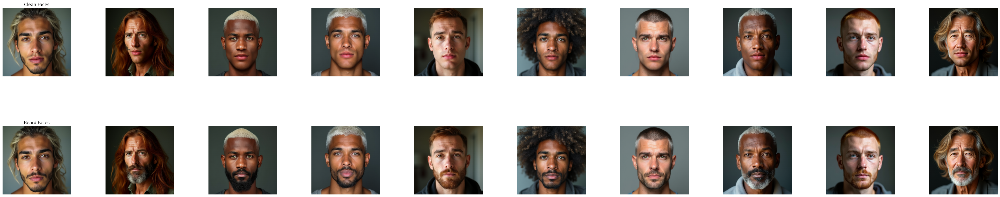

In [1]:
from utils.utils import display_images_side_by_side
display_images_side_by_side("dataset/dataset/CleanFaces","dataset/dataset/BeardFaces",titles= ("Clean Faces","Beard Faces"))

### Stage 2: Training a Lightweight Image-to-Image (img2img) Model
At this stage, we will train a U-Net like encoder-decoder architecture without skip connections, which is a basic Auto Encoder. Due to the constraits like time, computational resources, limited dataset etc. I had to train simplest model architecture to ensure that training will be avoiding mode collapses, instable training etc. This is the reason why I implement basic AE architecture. The model is trained with Adam optimizer, for about 90 epoch, with 5000 samples. Dataset siplited as train (%80) and validation (%20). Model completed without any spesific training strategies like lr scheduling, warmups, most recent optimizers like SGD-SAL/Apollo/Muon/soap, ema, knowledge distillation, identity preserving loss (arcface etc), finetuning a model which has prior knowledge about face reconstruction. These techniques can be considered as future works to improve models performance.



100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [1/200], Train Loss: 0.4884, Train PSNR: 5.0979, Train SSIM: 0.0734
Epoch [1/200], Val Loss: 0.4673, Val PSNR: 5.5213, Val SSIM: 0.1053


100%|██████████| 5/5 [00:08<00:00,  1.73s/it]


Epoch [2/200], Train Loss: 0.4517, Train PSNR: 5.7522, Train SSIM: 0.1241
Epoch [2/200], Val Loss: 0.4081, Val PSNR: 6.5644, Val SSIM: 0.1453


100%|██████████| 5/5 [00:08<00:00,  1.74s/it]


Epoch [3/200], Train Loss: 0.3552, Train PSNR: 7.4233, Train SSIM: 0.1122
Epoch [3/200], Val Loss: 0.3115, Val PSNR: 8.1263, Val SSIM: 0.0940


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [4/200], Train Loss: 0.2781, Train PSNR: 9.1137, Train SSIM: 0.1165
Epoch [4/200], Val Loss: 0.2312, Val PSNR: 10.6810, Val SSIM: 0.1766


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [5/200], Train Loss: 0.2178, Train PSNR: 11.0796, Train SSIM: 0.2004
Epoch [5/200], Val Loss: 0.1939, Val PSNR: 11.8199, Val SSIM: 0.2196


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [6/200], Train Loss: 0.1905, Train PSNR: 11.8922, Train SSIM: 0.2399
Epoch [6/200], Val Loss: 0.1734, Val PSNR: 12.6176, Val SSIM: 0.2938


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [7/200], Train Loss: 0.1717, Train PSNR: 12.7282, Train SSIM: 0.3241
Epoch [7/200], Val Loss: 0.1617, Val PSNR: 13.1376, Val SSIM: 0.3694


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [8/200], Train Loss: 0.1595, Train PSNR: 13.2503, Train SSIM: 0.3880
Epoch [8/200], Val Loss: 0.1474, Val PSNR: 13.8786, Val SSIM: 0.4280


100%|██████████| 5/5 [00:08<00:00,  1.70s/it]


Epoch [9/200], Train Loss: 0.1423, Train PSNR: 14.1492, Train SSIM: 0.4318
Epoch [9/200], Val Loss: 0.1323, Val PSNR: 14.6476, Val SSIM: 0.4541


100%|██████████| 5/5 [00:08<00:00,  1.70s/it]


Epoch [10/200], Train Loss: 0.1292, Train PSNR: 14.8031, Train SSIM: 0.4708
Epoch [10/200], Val Loss: 0.1238, Val PSNR: 15.0498, Val SSIM: 0.5019


100%|██████████| 5/5 [00:08<00:00,  1.69s/it]


Epoch [11/200], Train Loss: 0.1217, Train PSNR: 15.1079, Train SSIM: 0.5134
Epoch [11/200], Val Loss: 0.1166, Val PSNR: 15.3133, Val SSIM: 0.5206


100%|██████████| 5/5 [00:08<00:00,  1.75s/it]


Epoch [12/200], Train Loss: 0.1143, Train PSNR: 15.4552, Train SSIM: 0.5233
Epoch [12/200], Val Loss: 0.1103, Val PSNR: 15.6080, Val SSIM: 0.5513


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [13/200], Train Loss: 0.1095, Train PSNR: 15.6219, Train SSIM: 0.5636
Epoch [13/200], Val Loss: 0.1055, Val PSNR: 15.8038, Val SSIM: 0.5857


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [14/200], Train Loss: 0.1044, Train PSNR: 15.7989, Train SSIM: 0.5879
Epoch [14/200], Val Loss: 0.1012, Val PSNR: 15.9486, Val SSIM: 0.6079


100%|██████████| 5/5 [00:08<00:00,  1.66s/it]


Epoch [15/200], Train Loss: 0.1006, Train PSNR: 15.9721, Train SSIM: 0.6104
Epoch [15/200], Val Loss: 0.0987, Val PSNR: 16.0262, Val SSIM: 0.6343


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [16/200], Train Loss: 0.0986, Train PSNR: 16.0106, Train SSIM: 0.6352
Epoch [16/200], Val Loss: 0.0954, Val PSNR: 16.1449, Val SSIM: 0.6506


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [17/200], Train Loss: 0.0970, Train PSNR: 16.0256, Train SSIM: 0.6490
Epoch [17/200], Val Loss: 0.0930, Val PSNR: 16.2587, Val SSIM: 0.6597


100%|██████████| 5/5 [00:08<00:00,  1.64s/it]


Epoch [18/200], Train Loss: 0.0930, Train PSNR: 16.2484, Train SSIM: 0.6606
Epoch [18/200], Val Loss: 0.0909, Val PSNR: 16.3419, Val SSIM: 0.6633


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [19/200], Train Loss: 0.0900, Train PSNR: 16.4318, Train SSIM: 0.6670
Epoch [19/200], Val Loss: 0.0882, Val PSNR: 16.4320, Val SSIM: 0.6695


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [20/200], Train Loss: 0.0883, Train PSNR: 16.3758, Train SSIM: 0.6716
Epoch [20/200], Val Loss: 0.0858, Val PSNR: 16.5109, Val SSIM: 0.6768


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [21/200], Train Loss: 0.0857, Train PSNR: 16.4696, Train SSIM: 0.6781
Epoch [21/200], Val Loss: 0.0829, Val PSNR: 16.5991, Val SSIM: 0.6822


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [22/200], Train Loss: 0.0818, Train PSNR: 16.7201, Train SSIM: 0.6859
Epoch [22/200], Val Loss: 0.0811, Val PSNR: 16.6954, Val SSIM: 0.6869


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [23/200], Train Loss: 0.0811, Train PSNR: 16.7057, Train SSIM: 0.6874
Epoch [23/200], Val Loss: 0.0792, Val PSNR: 16.7298, Val SSIM: 0.6962


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [24/200], Train Loss: 0.0789, Train PSNR: 16.7536, Train SSIM: 0.6940
Epoch [24/200], Val Loss: 0.0768, Val PSNR: 16.8459, Val SSIM: 0.6984


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [25/200], Train Loss: 0.0768, Train PSNR: 16.8770, Train SSIM: 0.7005
Epoch [25/200], Val Loss: 0.0753, Val PSNR: 16.8984, Val SSIM: 0.7029


100%|██████████| 5/5 [00:08<00:00,  1.64s/it]


Epoch [26/200], Train Loss: 0.0762, Train PSNR: 16.8518, Train SSIM: 0.7031
Epoch [26/200], Val Loss: 0.0749, Val PSNR: 16.9296, Val SSIM: 0.7094


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [27/200], Train Loss: 0.0738, Train PSNR: 16.9736, Train SSIM: 0.7125
Epoch [27/200], Val Loss: 0.0725, Val PSNR: 17.0465, Val SSIM: 0.7150


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [28/200], Train Loss: 0.0724, Train PSNR: 17.1554, Train SSIM: 0.7174
Epoch [28/200], Val Loss: 0.0749, Val PSNR: 17.0451, Val SSIM: 0.7186


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [29/200], Train Loss: 0.0744, Train PSNR: 16.9529, Train SSIM: 0.7178
Epoch [29/200], Val Loss: 0.0746, Val PSNR: 17.0577, Val SSIM: 0.7205


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [30/200], Train Loss: 0.0729, Train PSNR: 17.1136, Train SSIM: 0.7248
Epoch [30/200], Val Loss: 0.0724, Val PSNR: 17.1301, Val SSIM: 0.7264


100%|██████████| 5/5 [00:08<00:00,  1.66s/it]


Epoch [31/200], Train Loss: 0.0710, Train PSNR: 17.3363, Train SSIM: 0.7269
Epoch [31/200], Val Loss: 0.0706, Val PSNR: 17.2170, Val SSIM: 0.7326


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [32/200], Train Loss: 0.0704, Train PSNR: 17.2699, Train SSIM: 0.7309
Epoch [32/200], Val Loss: 0.0696, Val PSNR: 17.3080, Val SSIM: 0.7330


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [33/200], Train Loss: 0.0683, Train PSNR: 17.3973, Train SSIM: 0.7371
Epoch [33/200], Val Loss: 0.0674, Val PSNR: 17.3450, Val SSIM: 0.7354


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [34/200], Train Loss: 0.0673, Train PSNR: 17.4907, Train SSIM: 0.7370
Epoch [34/200], Val Loss: 0.0678, Val PSNR: 17.3813, Val SSIM: 0.7375


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [35/200], Train Loss: 0.0667, Train PSNR: 17.4989, Train SSIM: 0.7407
Epoch [35/200], Val Loss: 0.0664, Val PSNR: 17.4643, Val SSIM: 0.7416


100%|██████████| 5/5 [00:08<00:00,  1.76s/it]


Epoch [36/200], Train Loss: 0.0655, Train PSNR: 17.6705, Train SSIM: 0.7450
Epoch [36/200], Val Loss: 0.0682, Val PSNR: 17.4163, Val SSIM: 0.7414


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [37/200], Train Loss: 0.0655, Train PSNR: 17.6167, Train SSIM: 0.7445
Epoch [37/200], Val Loss: 0.0656, Val PSNR: 17.5269, Val SSIM: 0.7472


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [38/200], Train Loss: 0.0644, Train PSNR: 17.6885, Train SSIM: 0.7486
Epoch [38/200], Val Loss: 0.0655, Val PSNR: 17.5779, Val SSIM: 0.7461


100%|██████████| 5/5 [00:08<00:00,  1.74s/it]


Epoch [39/200], Train Loss: 0.0639, Train PSNR: 17.7432, Train SSIM: 0.7492
Epoch [39/200], Val Loss: 0.0635, Val PSNR: 17.6010, Val SSIM: 0.7526


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [40/200], Train Loss: 0.0630, Train PSNR: 17.8893, Train SSIM: 0.7537
Epoch [40/200], Val Loss: 0.0627, Val PSNR: 17.6638, Val SSIM: 0.7543


100%|██████████| 5/5 [00:08<00:00,  1.70s/it]


Epoch [41/200], Train Loss: 0.0625, Train PSNR: 17.8472, Train SSIM: 0.7562
Epoch [41/200], Val Loss: 0.0640, Val PSNR: 17.7135, Val SSIM: 0.7518


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [42/200], Train Loss: 0.0634, Train PSNR: 17.6872, Train SSIM: 0.7527
Epoch [42/200], Val Loss: 0.0622, Val PSNR: 17.7791, Val SSIM: 0.7555


100%|██████████| 5/5 [00:08<00:00,  1.73s/it]


Epoch [43/200], Train Loss: 0.0607, Train PSNR: 18.0313, Train SSIM: 0.7586
Epoch [43/200], Val Loss: 0.0612, Val PSNR: 17.8198, Val SSIM: 0.7590


100%|██████████| 5/5 [00:08<00:00,  1.73s/it]


Epoch [44/200], Train Loss: 0.0606, Train PSNR: 18.1017, Train SSIM: 0.7618
Epoch [44/200], Val Loss: 0.0639, Val PSNR: 17.7881, Val SSIM: 0.7597


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [45/200], Train Loss: 0.0610, Train PSNR: 18.1029, Train SSIM: 0.7634
Epoch [45/200], Val Loss: 0.0608, Val PSNR: 17.8981, Val SSIM: 0.7600


100%|██████████| 5/5 [00:08<00:00,  1.74s/it]


Epoch [46/200], Train Loss: 0.0609, Train PSNR: 17.9547, Train SSIM: 0.7626
Epoch [46/200], Val Loss: 0.0612, Val PSNR: 17.9391, Val SSIM: 0.7618


100%|██████████| 5/5 [00:08<00:00,  1.69s/it]


Epoch [47/200], Train Loss: 0.0603, Train PSNR: 18.0645, Train SSIM: 0.7649
Epoch [47/200], Val Loss: 0.0622, Val PSNR: 17.9489, Val SSIM: 0.7627


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [48/200], Train Loss: 0.0595, Train PSNR: 18.2724, Train SSIM: 0.7677
Epoch [48/200], Val Loss: 0.0595, Val PSNR: 18.1053, Val SSIM: 0.7645


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [49/200], Train Loss: 0.0594, Train PSNR: 18.2121, Train SSIM: 0.7678
Epoch [49/200], Val Loss: 0.0585, Val PSNR: 18.1468, Val SSIM: 0.7685


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [50/200], Train Loss: 0.0586, Train PSNR: 18.3059, Train SSIM: 0.7707
Epoch [50/200], Val Loss: 0.0582, Val PSNR: 18.1851, Val SSIM: 0.7694


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [51/200], Train Loss: 0.0570, Train PSNR: 18.5038, Train SSIM: 0.7709
Epoch [51/200], Val Loss: 0.0586, Val PSNR: 18.2072, Val SSIM: 0.7684


100%|██████████| 5/5 [00:08<00:00,  1.73s/it]


Epoch [52/200], Train Loss: 0.0583, Train PSNR: 18.2964, Train SSIM: 0.7708
Epoch [52/200], Val Loss: 0.0573, Val PSNR: 18.3526, Val SSIM: 0.7717


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [53/200], Train Loss: 0.0571, Train PSNR: 18.5076, Train SSIM: 0.7741
Epoch [53/200], Val Loss: 0.0575, Val PSNR: 18.4433, Val SSIM: 0.7721


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [54/200], Train Loss: 0.0569, Train PSNR: 18.5804, Train SSIM: 0.7751
Epoch [54/200], Val Loss: 0.0577, Val PSNR: 18.5145, Val SSIM: 0.7726


100%|██████████| 5/5 [00:08<00:00,  1.66s/it]


Epoch [55/200], Train Loss: 0.0569, Train PSNR: 18.6043, Train SSIM: 0.7736
Epoch [55/200], Val Loss: 0.0558, Val PSNR: 18.6156, Val SSIM: 0.7759


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [56/200], Train Loss: 0.0553, Train PSNR: 18.9145, Train SSIM: 0.7799
Epoch [56/200], Val Loss: 0.0564, Val PSNR: 18.6614, Val SSIM: 0.7766


100%|██████████| 5/5 [00:08<00:00,  1.70s/it]


Epoch [57/200], Train Loss: 0.0571, Train PSNR: 18.8215, Train SSIM: 0.7743
Epoch [57/200], Val Loss: 0.0575, Val PSNR: 18.6442, Val SSIM: 0.7754


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [58/200], Train Loss: 0.0556, Train PSNR: 18.8704, Train SSIM: 0.7781
Epoch [58/200], Val Loss: 0.0561, Val PSNR: 18.8276, Val SSIM: 0.7758


100%|██████████| 5/5 [00:08<00:00,  1.70s/it]


Epoch [59/200], Train Loss: 0.0548, Train PSNR: 18.9356, Train SSIM: 0.7793
Epoch [59/200], Val Loss: 0.0545, Val PSNR: 19.0659, Val SSIM: 0.7796


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [60/200], Train Loss: 0.0538, Train PSNR: 19.2467, Train SSIM: 0.7821
Epoch [60/200], Val Loss: 0.0544, Val PSNR: 19.0811, Val SSIM: 0.7838


100%|██████████| 5/5 [00:08<00:00,  1.73s/it]


Epoch [61/200], Train Loss: 0.0543, Train PSNR: 19.3160, Train SSIM: 0.7823
Epoch [61/200], Val Loss: 0.0541, Val PSNR: 19.2277, Val SSIM: 0.7840


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [62/200], Train Loss: 0.0537, Train PSNR: 19.3092, Train SSIM: 0.7830
Epoch [62/200], Val Loss: 0.0529, Val PSNR: 19.3850, Val SSIM: 0.7822


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [63/200], Train Loss: 0.0526, Train PSNR: 19.5680, Train SSIM: 0.7855
Epoch [63/200], Val Loss: 0.0537, Val PSNR: 19.4680, Val SSIM: 0.7831


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [64/200], Train Loss: 0.0520, Train PSNR: 19.5756, Train SSIM: 0.7867
Epoch [64/200], Val Loss: 0.0528, Val PSNR: 19.6287, Val SSIM: 0.7836


100%|██████████| 5/5 [00:08<00:00,  1.70s/it]


Epoch [65/200], Train Loss: 0.0514, Train PSNR: 19.7044, Train SSIM: 0.7879
Epoch [65/200], Val Loss: 0.0524, Val PSNR: 19.6436, Val SSIM: 0.7872


100%|██████████| 5/5 [00:08<00:00,  1.70s/it]


Epoch [66/200], Train Loss: 0.0512, Train PSNR: 19.7708, Train SSIM: 0.7898
Epoch [66/200], Val Loss: 0.0527, Val PSNR: 19.8367, Val SSIM: 0.7846


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [67/200], Train Loss: 0.0517, Train PSNR: 19.8188, Train SSIM: 0.7884
Epoch [67/200], Val Loss: 0.0501, Val PSNR: 19.9615, Val SSIM: 0.7907


100%|██████████| 5/5 [00:08<00:00,  1.70s/it]


Epoch [68/200], Train Loss: 0.0513, Train PSNR: 19.9586, Train SSIM: 0.7905
Epoch [68/200], Val Loss: 0.0500, Val PSNR: 20.0384, Val SSIM: 0.7911


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [69/200], Train Loss: 0.0503, Train PSNR: 20.0937, Train SSIM: 0.7917
Epoch [69/200], Val Loss: 0.0517, Val PSNR: 20.0991, Val SSIM: 0.7885


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [70/200], Train Loss: 0.0507, Train PSNR: 19.9706, Train SSIM: 0.7909
Epoch [70/200], Val Loss: 0.0490, Val PSNR: 20.3016, Val SSIM: 0.7936


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [71/200], Train Loss: 0.0489, Train PSNR: 20.2624, Train SSIM: 0.7947
Epoch [71/200], Val Loss: 0.0485, Val PSNR: 20.4790, Val SSIM: 0.7936


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [72/200], Train Loss: 0.0487, Train PSNR: 20.2836, Train SSIM: 0.7949
Epoch [72/200], Val Loss: 0.0478, Val PSNR: 20.5239, Val SSIM: 0.7957


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [73/200], Train Loss: 0.0485, Train PSNR: 20.3053, Train SSIM: 0.7951
Epoch [73/200], Val Loss: 0.0490, Val PSNR: 20.3327, Val SSIM: 0.7961


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [74/200], Train Loss: 0.0489, Train PSNR: 20.3821, Train SSIM: 0.7968
Epoch [74/200], Val Loss: 0.0486, Val PSNR: 20.5368, Val SSIM: 0.7958


100%|██████████| 5/5 [00:08<00:00,  1.73s/it]


Epoch [75/200], Train Loss: 0.0470, Train PSNR: 20.6199, Train SSIM: 0.8012
Epoch [75/200], Val Loss: 0.0472, Val PSNR: 20.7289, Val SSIM: 0.8013


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [76/200], Train Loss: 0.0469, Train PSNR: 20.7131, Train SSIM: 0.8014
Epoch [76/200], Val Loss: 0.0462, Val PSNR: 20.9594, Val SSIM: 0.8022


100%|██████████| 5/5 [00:08<00:00,  1.75s/it]


Epoch [77/200], Train Loss: 0.0464, Train PSNR: 20.7819, Train SSIM: 0.8016
Epoch [77/200], Val Loss: 0.0455, Val PSNR: 20.9298, Val SSIM: 0.8036


100%|██████████| 5/5 [00:08<00:00,  1.74s/it]


Epoch [78/200], Train Loss: 0.0458, Train PSNR: 20.7389, Train SSIM: 0.8036
Epoch [78/200], Val Loss: 0.0457, Val PSNR: 20.8677, Val SSIM: 0.8043


100%|██████████| 5/5 [00:08<00:00,  1.74s/it]


Epoch [79/200], Train Loss: 0.0460, Train PSNR: 20.9402, Train SSIM: 0.8047
Epoch [79/200], Val Loss: 0.0449, Val PSNR: 21.1189, Val SSIM: 0.8057


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [80/200], Train Loss: 0.0447, Train PSNR: 21.0384, Train SSIM: 0.8062
Epoch [80/200], Val Loss: 0.0461, Val PSNR: 20.9077, Val SSIM: 0.8021


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [81/200], Train Loss: 0.0457, Train PSNR: 21.0394, Train SSIM: 0.8060
Epoch [81/200], Val Loss: 0.0445, Val PSNR: 21.2403, Val SSIM: 0.8078


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [82/200], Train Loss: 0.0454, Train PSNR: 21.0415, Train SSIM: 0.8073
Epoch [82/200], Val Loss: 0.0453, Val PSNR: 21.1988, Val SSIM: 0.8108


100%|██████████| 5/5 [00:08<00:00,  1.73s/it]


Epoch [83/200], Train Loss: 0.0448, Train PSNR: 21.2616, Train SSIM: 0.8122
Epoch [83/200], Val Loss: 0.0436, Val PSNR: 21.4075, Val SSIM: 0.8098


100%|██████████| 5/5 [00:08<00:00,  1.75s/it]


Epoch [84/200], Train Loss: 0.0438, Train PSNR: 21.2830, Train SSIM: 0.8127
Epoch [84/200], Val Loss: 0.0434, Val PSNR: 21.3977, Val SSIM: 0.8123


100%|██████████| 5/5 [00:08<00:00,  1.74s/it]


Epoch [85/200], Train Loss: 0.0436, Train PSNR: 21.3979, Train SSIM: 0.8119
Epoch [85/200], Val Loss: 0.0436, Val PSNR: 21.4457, Val SSIM: 0.8120


100%|██████████| 5/5 [00:08<00:00,  1.73s/it]


Epoch [86/200], Train Loss: 0.0431, Train PSNR: 21.4326, Train SSIM: 0.8138
Epoch [86/200], Val Loss: 0.0430, Val PSNR: 21.5302, Val SSIM: 0.8136


100%|██████████| 5/5 [00:08<00:00,  1.74s/it]


Epoch [87/200], Train Loss: 0.0425, Train PSNR: 21.5127, Train SSIM: 0.8154
Epoch [87/200], Val Loss: 0.0433, Val PSNR: 21.5689, Val SSIM: 0.8157


100%|██████████| 5/5 [00:08<00:00,  1.73s/it]


Epoch [88/200], Train Loss: 0.0435, Train PSNR: 21.3978, Train SSIM: 0.8156
Epoch [88/200], Val Loss: 0.0428, Val PSNR: 21.6085, Val SSIM: 0.8145


100%|██████████| 5/5 [00:08<00:00,  1.77s/it]


Epoch [89/200], Train Loss: 0.0429, Train PSNR: 21.5549, Train SSIM: 0.8170
Epoch [89/200], Val Loss: 0.0439, Val PSNR: 21.4173, Val SSIM: 0.8130


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [90/200], Train Loss: 0.0421, Train PSNR: 21.6482, Train SSIM: 0.8177
Epoch [90/200], Val Loss: 0.0428, Val PSNR: 21.7160, Val SSIM: 0.8158


100%|██████████| 5/5 [00:08<00:00,  1.73s/it]


Epoch [91/200], Train Loss: 0.0431, Train PSNR: 21.5215, Train SSIM: 0.8169
Epoch [91/200], Val Loss: 0.0424, Val PSNR: 21.7093, Val SSIM: 0.8172


100%|██████████| 5/5 [00:08<00:00,  1.79s/it]


Epoch [92/200], Train Loss: 0.0418, Train PSNR: 21.7157, Train SSIM: 0.8213
Epoch [92/200], Val Loss: 0.0418, Val PSNR: 21.7177, Val SSIM: 0.8181


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [93/200], Train Loss: 0.0415, Train PSNR: 21.7197, Train SSIM: 0.8226
Epoch [93/200], Val Loss: 0.0419, Val PSNR: 21.7947, Val SSIM: 0.8224


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [94/200], Train Loss: 0.0412, Train PSNR: 21.7563, Train SSIM: 0.8223
Epoch [94/200], Val Loss: 0.0420, Val PSNR: 21.7161, Val SSIM: 0.8190


100%|██████████| 5/5 [00:08<00:00,  1.76s/it]


Epoch [95/200], Train Loss: 0.0421, Train PSNR: 21.7154, Train SSIM: 0.8214
Epoch [95/200], Val Loss: 0.0432, Val PSNR: 21.6860, Val SSIM: 0.8209


100%|██████████| 5/5 [00:08<00:00,  1.73s/it]


Epoch [96/200], Train Loss: 0.0411, Train PSNR: 21.9057, Train SSIM: 0.8240
Epoch [96/200], Val Loss: 0.0428, Val PSNR: 21.8212, Val SSIM: 0.8242


100%|██████████| 5/5 [00:08<00:00,  1.66s/it]


Epoch [97/200], Train Loss: 0.0408, Train PSNR: 22.0190, Train SSIM: 0.8262
Epoch [97/200], Val Loss: 0.0414, Val PSNR: 21.9561, Val SSIM: 0.8242


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [98/200], Train Loss: 0.0403, Train PSNR: 21.9851, Train SSIM: 0.8261
Epoch [98/200], Val Loss: 0.0416, Val PSNR: 22.0362, Val SSIM: 0.8259


100%|██████████| 5/5 [00:08<00:00,  1.67s/it]


Epoch [99/200], Train Loss: 0.0405, Train PSNR: 21.9691, Train SSIM: 0.8251
Epoch [99/200], Val Loss: 0.0409, Val PSNR: 22.0429, Val SSIM: 0.8251


100%|██████████| 5/5 [00:08<00:00,  1.64s/it]


Epoch [100/200], Train Loss: 0.0401, Train PSNR: 22.0370, Train SSIM: 0.8274
Epoch [100/200], Val Loss: 0.0408, Val PSNR: 22.0411, Val SSIM: 0.8253


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [101/200], Train Loss: 0.0402, Train PSNR: 22.0807, Train SSIM: 0.8270
Epoch [101/200], Val Loss: 0.0415, Val PSNR: 22.0135, Val SSIM: 0.8255


100%|██████████| 5/5 [00:08<00:00,  1.64s/it]


Epoch [102/200], Train Loss: 0.0402, Train PSNR: 22.0486, Train SSIM: 0.8280
Epoch [102/200], Val Loss: 0.0418, Val PSNR: 22.0268, Val SSIM: 0.8254


100%|██████████| 5/5 [00:08<00:00,  1.66s/it]


Epoch [103/200], Train Loss: 0.0396, Train PSNR: 22.1156, Train SSIM: 0.8289
Epoch [103/200], Val Loss: 0.0403, Val PSNR: 22.1556, Val SSIM: 0.8275


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [104/200], Train Loss: 0.0390, Train PSNR: 22.2042, Train SSIM: 0.8308
Epoch [104/200], Val Loss: 0.0396, Val PSNR: 22.2225, Val SSIM: 0.8285


100%|██████████| 5/5 [00:08<00:00,  1.66s/it]


Epoch [105/200], Train Loss: 0.0390, Train PSNR: 22.2121, Train SSIM: 0.8305
Epoch [105/200], Val Loss: 0.0403, Val PSNR: 22.1712, Val SSIM: 0.8282


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [106/200], Train Loss: 0.0395, Train PSNR: 22.1411, Train SSIM: 0.8306
Epoch [106/200], Val Loss: 0.0390, Val PSNR: 22.2851, Val SSIM: 0.8301


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [107/200], Train Loss: 0.0383, Train PSNR: 22.2609, Train SSIM: 0.8325
Epoch [107/200], Val Loss: 0.0410, Val PSNR: 22.0664, Val SSIM: 0.8318


100%|██████████| 5/5 [00:08<00:00,  1.68s/it]


Epoch [108/200], Train Loss: 0.0388, Train PSNR: 22.3745, Train SSIM: 0.8336
Epoch [108/200], Val Loss: 0.0396, Val PSNR: 22.2375, Val SSIM: 0.8329


100%|██████████| 5/5 [00:08<00:00,  1.66s/it]


Epoch [109/200], Train Loss: 0.0389, Train PSNR: 22.1239, Train SSIM: 0.8340
Epoch [109/200], Val Loss: 0.0393, Val PSNR: 22.2954, Val SSIM: 0.8318


100%|██████████| 5/5 [00:08<00:00,  1.74s/it]


Epoch [110/200], Train Loss: 0.0385, Train PSNR: 22.2885, Train SSIM: 0.8343
Epoch [110/200], Val Loss: 0.0390, Val PSNR: 22.3448, Val SSIM: 0.8332


100%|██████████| 5/5 [00:08<00:00,  1.66s/it]


Epoch [111/200], Train Loss: 0.0388, Train PSNR: 22.2776, Train SSIM: 0.8343
Epoch [111/200], Val Loss: 0.0386, Val PSNR: 22.4064, Val SSIM: 0.8324


100%|██████████| 5/5 [00:08<00:00,  1.64s/it]


Epoch [112/200], Train Loss: 0.0374, Train PSNR: 22.4702, Train SSIM: 0.8365
Epoch [112/200], Val Loss: 0.0393, Val PSNR: 22.2852, Val SSIM: 0.8314


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [113/200], Train Loss: 0.0382, Train PSNR: 22.4124, Train SSIM: 0.8360
Epoch [113/200], Val Loss: 0.0393, Val PSNR: 22.4420, Val SSIM: 0.8370


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [114/200], Train Loss: 0.0381, Train PSNR: 22.3517, Train SSIM: 0.8368
Epoch [114/200], Val Loss: 0.0421, Val PSNR: 21.9043, Val SSIM: 0.8312


100%|██████████| 5/5 [00:08<00:00,  1.70s/it]


Epoch [115/200], Train Loss: 0.0397, Train PSNR: 22.3570, Train SSIM: 0.8346
Epoch [115/200], Val Loss: 0.0388, Val PSNR: 22.3475, Val SSIM: 0.8357


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [116/200], Train Loss: 0.0381, Train PSNR: 22.5567, Train SSIM: 0.8391
Epoch [116/200], Val Loss: 0.0408, Val PSNR: 22.3865, Val SSIM: 0.8318


100%|██████████| 5/5 [00:08<00:00,  1.66s/it]


Epoch [117/200], Train Loss: 0.0381, Train PSNR: 22.5046, Train SSIM: 0.8379
Epoch [117/200], Val Loss: 0.0381, Val PSNR: 22.4545, Val SSIM: 0.8336


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [118/200], Train Loss: 0.0374, Train PSNR: 22.5785, Train SSIM: 0.8388
Epoch [118/200], Val Loss: 0.0385, Val PSNR: 22.5160, Val SSIM: 0.8371


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [119/200], Train Loss: 0.0367, Train PSNR: 22.7593, Train SSIM: 0.8410
Epoch [119/200], Val Loss: 0.0373, Val PSNR: 22.5960, Val SSIM: 0.8383


100%|██████████| 5/5 [00:08<00:00,  1.61s/it]


Epoch [120/200], Train Loss: 0.0370, Train PSNR: 22.5893, Train SSIM: 0.8400
Epoch [120/200], Val Loss: 0.0383, Val PSNR: 22.4849, Val SSIM: 0.8380


100%|██████████| 5/5 [00:08<00:00,  1.61s/it]


Epoch [121/200], Train Loss: 0.0368, Train PSNR: 22.6493, Train SSIM: 0.8414
Epoch [121/200], Val Loss: 0.0373, Val PSNR: 22.6335, Val SSIM: 0.8387


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [122/200], Train Loss: 0.0363, Train PSNR: 22.6769, Train SSIM: 0.8413
Epoch [122/200], Val Loss: 0.0380, Val PSNR: 22.3449, Val SSIM: 0.8371


100%|██████████| 5/5 [00:08<00:00,  1.60s/it]


Epoch [123/200], Train Loss: 0.0368, Train PSNR: 22.6366, Train SSIM: 0.8411
Epoch [123/200], Val Loss: 0.0368, Val PSNR: 22.6709, Val SSIM: 0.8406


100%|██████████| 5/5 [00:08<00:00,  1.60s/it]


Epoch [124/200], Train Loss: 0.0364, Train PSNR: 22.7298, Train SSIM: 0.8422
Epoch [124/200], Val Loss: 0.0370, Val PSNR: 22.7019, Val SSIM: 0.8403


100%|██████████| 5/5 [00:08<00:00,  1.60s/it]


Epoch [125/200], Train Loss: 0.0356, Train PSNR: 22.8631, Train SSIM: 0.8440
Epoch [125/200], Val Loss: 0.0376, Val PSNR: 22.6838, Val SSIM: 0.8403


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [126/200], Train Loss: 0.0365, Train PSNR: 22.7566, Train SSIM: 0.8430
Epoch [126/200], Val Loss: 0.0374, Val PSNR: 22.6276, Val SSIM: 0.8409


100%|██████████| 5/5 [00:08<00:00,  1.62s/it]


Epoch [127/200], Train Loss: 0.0363, Train PSNR: 22.8108, Train SSIM: 0.8440
Epoch [127/200], Val Loss: 0.0365, Val PSNR: 22.6920, Val SSIM: 0.8422


100%|██████████| 5/5 [00:08<00:00,  1.60s/it]


Epoch [128/200], Train Loss: 0.0364, Train PSNR: 22.6352, Train SSIM: 0.8427
Epoch [128/200], Val Loss: 0.0371, Val PSNR: 22.6044, Val SSIM: 0.8420


100%|██████████| 5/5 [00:08<00:00,  1.60s/it]


Epoch [129/200], Train Loss: 0.0354, Train PSNR: 22.8944, Train SSIM: 0.8449
Epoch [129/200], Val Loss: 0.0367, Val PSNR: 22.7996, Val SSIM: 0.8405


100%|██████████| 5/5 [00:08<00:00,  1.64s/it]


Epoch [130/200], Train Loss: 0.0350, Train PSNR: 23.0749, Train SSIM: 0.8474
Epoch [130/200], Val Loss: 0.0371, Val PSNR: 22.5216, Val SSIM: 0.8420


100%|██████████| 5/5 [00:08<00:00,  1.72s/it]


Epoch [131/200], Train Loss: 0.0352, Train PSNR: 22.9675, Train SSIM: 0.8478
Epoch [131/200], Val Loss: 0.0358, Val PSNR: 22.8812, Val SSIM: 0.8450


100%|██████████| 5/5 [00:08<00:00,  1.66s/it]


Epoch [132/200], Train Loss: 0.0366, Train PSNR: 22.6952, Train SSIM: 0.8451
Epoch [132/200], Val Loss: 0.0370, Val PSNR: 22.7869, Val SSIM: 0.8432


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [133/200], Train Loss: 0.0352, Train PSNR: 22.9164, Train SSIM: 0.8485
Epoch [133/200], Val Loss: 0.0366, Val PSNR: 22.8241, Val SSIM: 0.8449


100%|██████████| 5/5 [00:08<00:00,  1.62s/it]


Epoch [134/200], Train Loss: 0.0356, Train PSNR: 22.9458, Train SSIM: 0.8479
Epoch [134/200], Val Loss: 0.0361, Val PSNR: 22.9118, Val SSIM: 0.8451


100%|██████████| 5/5 [00:07<00:00,  1.59s/it]


Epoch [135/200], Train Loss: 0.0350, Train PSNR: 23.0273, Train SSIM: 0.8481
Epoch [135/200], Val Loss: 0.0354, Val PSNR: 22.8995, Val SSIM: 0.8470


100%|██████████| 5/5 [00:07<00:00,  1.59s/it]


Epoch [136/200], Train Loss: 0.0342, Train PSNR: 23.1070, Train SSIM: 0.8505
Epoch [136/200], Val Loss: 0.0362, Val PSNR: 22.9171, Val SSIM: 0.8457


100%|██████████| 5/5 [00:08<00:00,  1.60s/it]


Epoch [137/200], Train Loss: 0.0346, Train PSNR: 23.1284, Train SSIM: 0.8502
Epoch [137/200], Val Loss: 0.0361, Val PSNR: 22.8927, Val SSIM: 0.8474


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [138/200], Train Loss: 0.0343, Train PSNR: 23.1815, Train SSIM: 0.8507
Epoch [138/200], Val Loss: 0.0353, Val PSNR: 22.9823, Val SSIM: 0.8473


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [139/200], Train Loss: 0.0348, Train PSNR: 23.0796, Train SSIM: 0.8507
Epoch [139/200], Val Loss: 0.0365, Val PSNR: 22.9723, Val SSIM: 0.8501


100%|██████████| 5/5 [00:08<00:00,  1.67s/it]


Epoch [140/200], Train Loss: 0.0347, Train PSNR: 23.2127, Train SSIM: 0.8528
Epoch [140/200], Val Loss: 0.0363, Val PSNR: 22.5783, Val SSIM: 0.8453


100%|██████████| 5/5 [00:08<00:00,  1.64s/it]


Epoch [141/200], Train Loss: 0.0346, Train PSNR: 23.0682, Train SSIM: 0.8506
Epoch [141/200], Val Loss: 0.0366, Val PSNR: 22.9728, Val SSIM: 0.8509


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [142/200], Train Loss: 0.0355, Train PSNR: 23.0327, Train SSIM: 0.8502
Epoch [142/200], Val Loss: 0.0356, Val PSNR: 22.8671, Val SSIM: 0.8491


100%|██████████| 5/5 [00:08<00:00,  1.62s/it]


Epoch [143/200], Train Loss: 0.0339, Train PSNR: 23.2581, Train SSIM: 0.8533
Epoch [143/200], Val Loss: 0.0350, Val PSNR: 22.9452, Val SSIM: 0.8501


100%|██████████| 5/5 [00:07<00:00,  1.59s/it]


Epoch [144/200], Train Loss: 0.0339, Train PSNR: 23.2628, Train SSIM: 0.8533
Epoch [144/200], Val Loss: 0.0360, Val PSNR: 22.9554, Val SSIM: 0.8510


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [145/200], Train Loss: 0.0340, Train PSNR: 23.3002, Train SSIM: 0.8543
Epoch [145/200], Val Loss: 0.0352, Val PSNR: 22.9524, Val SSIM: 0.8502


100%|██████████| 5/5 [00:08<00:00,  1.61s/it]


Epoch [146/200], Train Loss: 0.0336, Train PSNR: 23.1270, Train SSIM: 0.8543
Epoch [146/200], Val Loss: 0.0347, Val PSNR: 23.0785, Val SSIM: 0.8506


100%|██████████| 5/5 [00:08<00:00,  1.62s/it]


Epoch [147/200], Train Loss: 0.0333, Train PSNR: 23.3205, Train SSIM: 0.8556
Epoch [147/200], Val Loss: 0.0366, Val PSNR: 22.9834, Val SSIM: 0.8488


100%|██████████| 5/5 [00:07<00:00,  1.58s/it]


Epoch [148/200], Train Loss: 0.0337, Train PSNR: 23.3490, Train SSIM: 0.8548
Epoch [148/200], Val Loss: 0.0365, Val PSNR: 23.0132, Val SSIM: 0.8497


100%|██████████| 5/5 [00:07<00:00,  1.58s/it]


Epoch [149/200], Train Loss: 0.0334, Train PSNR: 23.4102, Train SSIM: 0.8559
Epoch [149/200], Val Loss: 0.0347, Val PSNR: 23.0849, Val SSIM: 0.8525


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [150/200], Train Loss: 0.0328, Train PSNR: 23.4306, Train SSIM: 0.8574
Epoch [150/200], Val Loss: 0.0343, Val PSNR: 23.1306, Val SSIM: 0.8535


100%|██████████| 5/5 [00:07<00:00,  1.59s/it]


Epoch [151/200], Train Loss: 0.0338, Train PSNR: 23.1457, Train SSIM: 0.8558
Epoch [151/200], Val Loss: 0.0350, Val PSNR: 22.9747, Val SSIM: 0.8518


100%|██████████| 5/5 [00:08<00:00,  1.60s/it]


Epoch [152/200], Train Loss: 0.0336, Train PSNR: 23.1178, Train SSIM: 0.8559
Epoch [152/200], Val Loss: 0.0344, Val PSNR: 23.1566, Val SSIM: 0.8530


100%|██████████| 5/5 [00:07<00:00,  1.59s/it]


Epoch [153/200], Train Loss: 0.0333, Train PSNR: 23.4532, Train SSIM: 0.8568
Epoch [153/200], Val Loss: 0.0377, Val PSNR: 22.9139, Val SSIM: 0.8506


100%|██████████| 5/5 [00:07<00:00,  1.59s/it]


Epoch [154/200], Train Loss: 0.0339, Train PSNR: 23.4348, Train SSIM: 0.8576
Epoch [154/200], Val Loss: 0.0359, Val PSNR: 22.8818, Val SSIM: 0.8522


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [155/200], Train Loss: 0.0332, Train PSNR: 23.2227, Train SSIM: 0.8584
Epoch [155/200], Val Loss: 0.0339, Val PSNR: 23.2057, Val SSIM: 0.8547


100%|██████████| 5/5 [00:07<00:00,  1.59s/it]


Epoch [156/200], Train Loss: 0.0325, Train PSNR: 23.5031, Train SSIM: 0.8586
Epoch [156/200], Val Loss: 0.0346, Val PSNR: 23.1820, Val SSIM: 0.8538


100%|██████████| 5/5 [00:08<00:00,  1.60s/it]


Epoch [157/200], Train Loss: 0.0324, Train PSNR: 23.5599, Train SSIM: 0.8598
Epoch [157/200], Val Loss: 0.0351, Val PSNR: 23.0866, Val SSIM: 0.8542


100%|██████████| 5/5 [00:07<00:00,  1.59s/it]


Epoch [158/200], Train Loss: 0.0330, Train PSNR: 23.5341, Train SSIM: 0.8602
Epoch [158/200], Val Loss: 0.0362, Val PSNR: 23.0807, Val SSIM: 0.8540


100%|██████████| 5/5 [00:08<00:00,  1.61s/it]


Epoch [159/200], Train Loss: 0.0325, Train PSNR: 23.7135, Train SSIM: 0.8618
Epoch [159/200], Val Loss: 0.0335, Val PSNR: 23.2683, Val SSIM: 0.8566


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [160/200], Train Loss: 0.0323, Train PSNR: 23.5744, Train SSIM: 0.8605
Epoch [160/200], Val Loss: 0.0335, Val PSNR: 23.2232, Val SSIM: 0.8561


100%|██████████| 5/5 [00:08<00:00,  1.60s/it]


Epoch [161/200], Train Loss: 0.0320, Train PSNR: 23.6437, Train SSIM: 0.8614
Epoch [161/200], Val Loss: 0.0335, Val PSNR: 23.3105, Val SSIM: 0.8579


100%|██████████| 5/5 [00:08<00:00,  1.62s/it]


Epoch [162/200], Train Loss: 0.0319, Train PSNR: 23.6940, Train SSIM: 0.8628
Epoch [162/200], Val Loss: 0.0337, Val PSNR: 23.1942, Val SSIM: 0.8560


100%|██████████| 5/5 [00:08<00:00,  1.67s/it]


Epoch [163/200], Train Loss: 0.0324, Train PSNR: 23.5531, Train SSIM: 0.8615
Epoch [163/200], Val Loss: 0.0335, Val PSNR: 23.3626, Val SSIM: 0.8587


100%|██████████| 5/5 [00:08<00:00,  1.67s/it]


Epoch [164/200], Train Loss: 0.0320, Train PSNR: 23.6832, Train SSIM: 0.8623
Epoch [164/200], Val Loss: 0.0331, Val PSNR: 23.3696, Val SSIM: 0.8585


100%|██████████| 5/5 [00:08<00:00,  1.68s/it]


Epoch [165/200], Train Loss: 0.0311, Train PSNR: 23.8232, Train SSIM: 0.8637
Epoch [165/200], Val Loss: 0.0332, Val PSNR: 23.3565, Val SSIM: 0.8573


100%|██████████| 5/5 [00:08<00:00,  1.69s/it]


Epoch [166/200], Train Loss: 0.0318, Train PSNR: 23.7598, Train SSIM: 0.8618
Epoch [166/200], Val Loss: 0.0332, Val PSNR: 23.3501, Val SSIM: 0.8585


100%|██████████| 5/5 [00:08<00:00,  1.67s/it]


Epoch [167/200], Train Loss: 0.0322, Train PSNR: 23.4546, Train SSIM: 0.8629
Epoch [167/200], Val Loss: 0.0338, Val PSNR: 23.3119, Val SSIM: 0.8604


100%|██████████| 5/5 [00:08<00:00,  1.67s/it]


Epoch [168/200], Train Loss: 0.0316, Train PSNR: 23.8083, Train SSIM: 0.8641
Epoch [168/200], Val Loss: 0.0335, Val PSNR: 23.2744, Val SSIM: 0.8576


100%|██████████| 5/5 [00:08<00:00,  1.68s/it]


Epoch [169/200], Train Loss: 0.0316, Train PSNR: 23.7657, Train SSIM: 0.8641
Epoch [169/200], Val Loss: 0.0328, Val PSNR: 23.4062, Val SSIM: 0.8599


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [170/200], Train Loss: 0.0312, Train PSNR: 23.8599, Train SSIM: 0.8651
Epoch [170/200], Val Loss: 0.0326, Val PSNR: 23.4547, Val SSIM: 0.8601


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [171/200], Train Loss: 0.0308, Train PSNR: 23.9241, Train SSIM: 0.8657
Epoch [171/200], Val Loss: 0.0331, Val PSNR: 23.4006, Val SSIM: 0.8601


100%|██████████| 5/5 [00:08<00:00,  1.66s/it]


Epoch [172/200], Train Loss: 0.0314, Train PSNR: 23.7725, Train SSIM: 0.8650
Epoch [172/200], Val Loss: 0.0336, Val PSNR: 23.2918, Val SSIM: 0.8599


100%|██████████| 5/5 [00:08<00:00,  1.67s/it]


Epoch [173/200], Train Loss: 0.0313, Train PSNR: 23.7557, Train SSIM: 0.8654
Epoch [173/200], Val Loss: 0.0341, Val PSNR: 23.3017, Val SSIM: 0.8608


100%|██████████| 5/5 [00:08<00:00,  1.66s/it]


Epoch [174/200], Train Loss: 0.0311, Train PSNR: 23.9375, Train SSIM: 0.8662
Epoch [174/200], Val Loss: 0.0329, Val PSNR: 23.3199, Val SSIM: 0.8602


100%|██████████| 5/5 [00:08<00:00,  1.73s/it]


Epoch [175/200], Train Loss: 0.0309, Train PSNR: 23.8787, Train SSIM: 0.8676
Epoch [175/200], Val Loss: 0.0332, Val PSNR: 23.4337, Val SSIM: 0.8624


100%|██████████| 5/5 [00:08<00:00,  1.71s/it]


Epoch [176/200], Train Loss: 0.0310, Train PSNR: 23.8909, Train SSIM: 0.8667
Epoch [176/200], Val Loss: 0.0325, Val PSNR: 23.5492, Val SSIM: 0.8629


100%|██████████| 5/5 [00:09<00:00,  1.81s/it]


Epoch [177/200], Train Loss: 0.0306, Train PSNR: 23.9827, Train SSIM: 0.8670
Epoch [177/200], Val Loss: 0.0329, Val PSNR: 23.3404, Val SSIM: 0.8610


100%|██████████| 5/5 [00:08<00:00,  1.75s/it]


Epoch [178/200], Train Loss: 0.0306, Train PSNR: 24.0176, Train SSIM: 0.8679
Epoch [178/200], Val Loss: 0.0323, Val PSNR: 23.5335, Val SSIM: 0.8613


100%|██████████| 5/5 [00:08<00:00,  1.74s/it]


Epoch [179/200], Train Loss: 0.0301, Train PSNR: 24.0926, Train SSIM: 0.8690
Epoch [179/200], Val Loss: 0.0325, Val PSNR: 23.4536, Val SSIM: 0.8619


100%|██████████| 5/5 [00:08<00:00,  1.68s/it]


Epoch [180/200], Train Loss: 0.0304, Train PSNR: 24.0064, Train SSIM: 0.8680
Epoch [180/200], Val Loss: 0.0323, Val PSNR: 23.4664, Val SSIM: 0.8632


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [181/200], Train Loss: 0.0304, Train PSNR: 24.0489, Train SSIM: 0.8686
Epoch [181/200], Val Loss: 0.0335, Val PSNR: 23.5261, Val SSIM: 0.8636


100%|██████████| 5/5 [00:08<00:00,  1.65s/it]


Epoch [182/200], Train Loss: 0.0305, Train PSNR: 24.1410, Train SSIM: 0.8692
Epoch [182/200], Val Loss: 0.0344, Val PSNR: 23.2273, Val SSIM: 0.8617


100%|██████████| 5/5 [00:08<00:00,  1.67s/it]


Epoch [183/200], Train Loss: 0.0303, Train PSNR: 24.0500, Train SSIM: 0.8693
Epoch [183/200], Val Loss: 0.0326, Val PSNR: 23.5582, Val SSIM: 0.8645


100%|██████████| 5/5 [00:08<00:00,  1.62s/it]


Epoch [184/200], Train Loss: 0.0300, Train PSNR: 24.1325, Train SSIM: 0.8703
Epoch [184/200], Val Loss: 0.0325, Val PSNR: 23.5222, Val SSIM: 0.8622


100%|██████████| 5/5 [00:08<00:00,  1.61s/it]


Epoch [185/200], Train Loss: 0.0299, Train PSNR: 24.1560, Train SSIM: 0.8700
Epoch [185/200], Val Loss: 0.0326, Val PSNR: 23.5909, Val SSIM: 0.8651


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [186/200], Train Loss: 0.0302, Train PSNR: 24.1475, Train SSIM: 0.8699
Epoch [186/200], Val Loss: 0.0320, Val PSNR: 23.5597, Val SSIM: 0.8647


100%|██████████| 5/5 [00:08<00:00,  1.61s/it]


Epoch [187/200], Train Loss: 0.0304, Train PSNR: 24.0870, Train SSIM: 0.8699
Epoch [187/200], Val Loss: 0.0316, Val PSNR: 23.6019, Val SSIM: 0.8658


100%|██████████| 5/5 [00:08<00:00,  1.64s/it]


Epoch [188/200], Train Loss: 0.0299, Train PSNR: 24.1480, Train SSIM: 0.8698
Epoch [188/200], Val Loss: 0.0322, Val PSNR: 23.5643, Val SSIM: 0.8664


100%|██████████| 5/5 [00:08<00:00,  1.67s/it]


Epoch [189/200], Train Loss: 0.0299, Train PSNR: 24.1612, Train SSIM: 0.8708
Epoch [189/200], Val Loss: 0.0337, Val PSNR: 23.2359, Val SSIM: 0.8639


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [190/200], Train Loss: 0.0298, Train PSNR: 24.1208, Train SSIM: 0.8719
Epoch [190/200], Val Loss: 0.0321, Val PSNR: 23.5996, Val SSIM: 0.8668


100%|██████████| 5/5 [00:08<00:00,  1.63s/it]


Epoch [191/200], Train Loss: 0.0296, Train PSNR: 24.1738, Train SSIM: 0.8710
Epoch [191/200], Val Loss: 0.0320, Val PSNR: 23.5334, Val SSIM: 0.8661


100%|██████████| 5/5 [00:08<00:00,  1.62s/it]


Epoch [192/200], Train Loss: 0.0298, Train PSNR: 24.2961, Train SSIM: 0.8722
Epoch [192/200], Val Loss: 0.0317, Val PSNR: 23.5779, Val SSIM: 0.8653


100%|██████████| 5/5 [00:08<00:00,  1.60s/it]


Epoch [193/200], Train Loss: 0.0293, Train PSNR: 24.3198, Train SSIM: 0.8723
Epoch [193/200], Val Loss: 0.0323, Val PSNR: 23.5335, Val SSIM: 0.8662


100%|██████████| 5/5 [00:07<00:00,  1.59s/it]


Epoch [194/200], Train Loss: 0.0291, Train PSNR: 24.3644, Train SSIM: 0.8735
Epoch [194/200], Val Loss: 0.0319, Val PSNR: 23.4942, Val SSIM: 0.8651


100%|██████████| 5/5 [00:07<00:00,  1.60s/it]


Epoch [195/200], Train Loss: 0.0297, Train PSNR: 24.2697, Train SSIM: 0.8726
Epoch [195/200], Val Loss: 0.0313, Val PSNR: 23.6614, Val SSIM: 0.8670


100%|██████████| 5/5 [00:07<00:00,  1.59s/it]


Epoch [196/200], Train Loss: 0.0298, Train PSNR: 24.2578, Train SSIM: 0.8719
Epoch [196/200], Val Loss: 0.0350, Val PSNR: 22.9740, Val SSIM: 0.8635


100%|██████████| 5/5 [00:07<00:00,  1.59s/it]


Epoch [197/200], Train Loss: 0.0305, Train PSNR: 24.0648, Train SSIM: 0.8718
Epoch [197/200], Val Loss: 0.0342, Val PSNR: 23.5085, Val SSIM: 0.8642


100%|██████████| 5/5 [00:07<00:00,  1.60s/it]


Epoch [198/200], Train Loss: 0.0303, Train PSNR: 24.2489, Train SSIM: 0.8731
Epoch [198/200], Val Loss: 0.0339, Val PSNR: 23.4348, Val SSIM: 0.8692


100%|██████████| 5/5 [00:07<00:00,  1.59s/it]


Epoch [199/200], Train Loss: 0.0306, Train PSNR: 23.9974, Train SSIM: 0.8715
Epoch [199/200], Val Loss: 0.0319, Val PSNR: 23.6525, Val SSIM: 0.8671


100%|██████████| 5/5 [00:07<00:00,  1.59s/it]


Epoch [200/200], Train Loss: 0.0295, Train PSNR: 24.2408, Train SSIM: 0.8726
Epoch [200/200], Val Loss: 0.0323, Val PSNR: 23.4008, Val SSIM: 0.8640


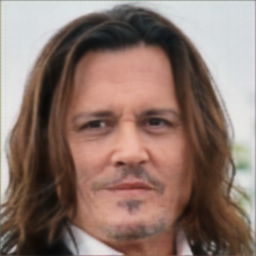

In [4]:
from training.train import train_and_evaluate
train_and_evaluate()

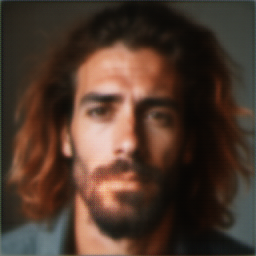

In [2]:
from testing.test import test
best_model_path = "training/checkpoints/best_model_epoch_40_val_loss_0.1270.pth"
test("dataset/dataset/BeardFaces/example0.png",f"./{best_model_path}")

In [3]:
from PIL import Image
Image.open("results/epoch_40_input.png")

FileNotFoundError: [Errno 2] No such file or directory: 'results/epoch_40_input.png'

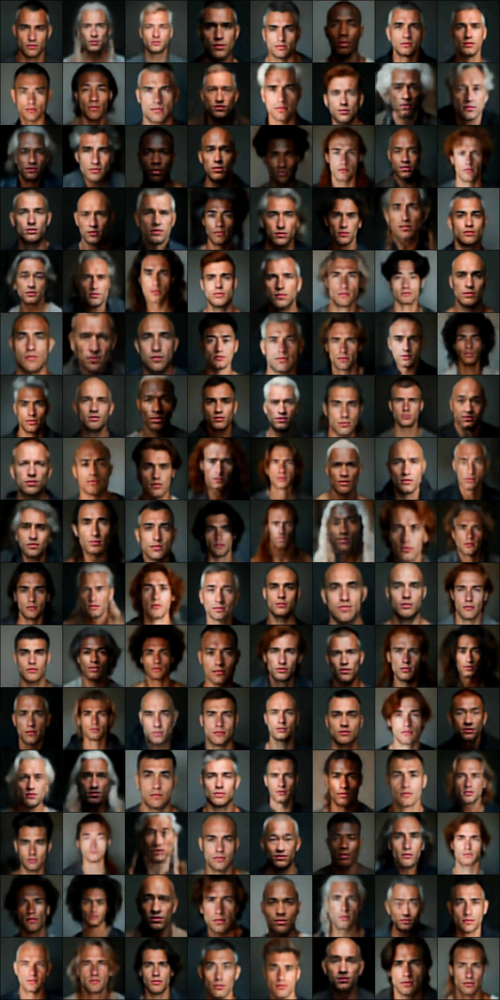

In [ ]:

Image.open("results/epoch_98_output.png")